# Life expectancy prediction

## Michael Leung

## Contact: michaelleung341@gmail.com

### i. Introduction
As the life expectancy increase around the world over decades around the world. As a bachelor of science and a data science learner, my goal of the project is to find out what are the key factors that affect life expectancy with the help of machine learning.

I think life expectancy predication is important in different levels:

- For personal, life expectancy prediction is important because we can make out furure plan and keep savings base on it, to maintain the life quality for the future life.

- For companies or orginatizations, they can to educate the public and provide suitable products or services for their customers at different age.

- For government, they can try to investigate for what is the key factor to determine life expectancy and implement policies to help to extand the life expectancy or deal with the aging problem.

With the about reason, I think having a realiable way to predict the life expectancy is a good way to improve our quality of life. 
If I can find a raliable dataset with large amount of data and features, I think it is worth to try to use machine learning to build a model to predict the life expectancy.

### ii. Work process
- Search for the suitable dataset for the analysis of life expectancy.
- Perform data cleaning to get a dataset that is good for exploratory data analysis and modeling.
- Perform exploratory data analysis to find out the some patterns on how the environment factors affects the life expectancy.
- Build different model to find out which model has better predicting power.
- Find out what are the most important features that affects the life expectancy from the model.

### iii. Search for suitable dataset
I searched for the data set of life expectancy, but the dataset I found were mostly life expectancy over year of different countries. Then I tried to think about my goal is to find out what important factors affect the life expectancy, so I come out of an idea on finding the dataset about quality of life .

I ended up chose the world development index data set from World Bank published in 2022<sub>[Ref_1](#1)</sub>, it has a large amount of features and data from differnt countries. The data should be realiable as it has citations of where feature data came from.

The original dataset has over 1000 features and the data were collected annually from different countries.

## iv.Data cleaning
- [Data frame reshape](#reshape)
- [Deal with missing data](#miss)
- [Exploratory data analysis](#EDA)
- [Feature selection](#select)

## v. Modeling
- [Linear regression model](#linear)
- [Lasso/Ridge model](#mod_linear)
- [KNN regressor model](#knn)
- [SVR model](#svr)
- [Decision tree regression model](#tree)
- [Random forest model](#forest)

## [vi.Model evaluation](#evaluation)

## [vii.Conclusion](#conclusion)

## [iii.Limition](#limition)

## [ix.Future action](#future)

## [x.References](#references)


## iv. Data cleaning
## <a id='reshape'>Data frame reshape</a>

Before data cleaning, we need to import the tools 

In [1]:
# import the tools we need for data cleaning
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# ignore the warnings from jupyter notebook
import warnings
warnings.filterwarnings("ignore")

In [3]:
# read the dataset
df = pd.read_csv('data/WDIData.csv', index_col = False)

In [4]:
# See the size of data frame
print(f'The data frame has {df.shape[0]} rows and {df.shape[1]} columns')

The data frame has 383572 rows and 66 columns


In [5]:
# Indicator code is the brief classisifcation of the indicator name, which is not necessary for the analysis
df = df.drop('Indicator Code',axis = 1)

In [6]:
df.head()

,Country Name,Country Code,Indicator Name,1960,1961,1962,1963,1964,1965,1966,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
0,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,16.559819,16.936004,17.337896,17.687092,18.140971,18.491344,18.825520,19.272212,19.628009,NaN
1,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,6.281667,6.499471,6.680066,6.859110,7.016238,7.180364,7.322294,7.517191,7.651598,NaN
2,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,37.601816,37.855399,38.046781,38.326255,38.468426,38.670044,38.722783,38.927016,39.042839,NaN
3,Africa Eastern and Southern,AFE,Access to electricity (% of population),NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,31.844384,31.794160,32.001027,33.871910,38.880173,40.261358,43.061877,44.270860,45.803485,NaN
4,Africa Eastern and Southern,AFE,"Access to electricity, rural (% of rural popul...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19.402592,18.663502,17.633986,16.464681,24.531436,25.345111,27.449908,29.641760,30.404935,NaN


We can see that the data frame has different features in different rows. We can see where are the rows of life expecancy.

In [7]:
df[df['Indicator Name']=='Life expectancy at birth, total (years)']

,Country Name,Country Code,Indicator Name,1960,1961,1962,1963,1964,1965,1966,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
697,Africa Eastern and Southern,AFE,"Life expectancy at birth, total (years)",42.716053,43.166935,43.603990,44.025617,44.432721,44.826919,45.213048,...,60.185561,60.953363,61.647367,62.259288,62.787681,63.246264,63.648988,64.005213,64.325702,NaN
2139,Africa Western and Central,AFW,"Life expectancy at birth, total (years)",37.205380,37.632546,38.052612,38.463746,38.867073,39.264841,39.662762,...,55.138944,55.618986,56.088269,56.542009,56.974761,57.382363,57.762347,58.115723,58.445953,NaN
3581,Arab World,ARB,"Life expectancy at birth, total (years)",46.546909,47.141620,47.731782,48.320433,48.910019,49.496477,50.072949,...,70.703798,70.882218,71.064269,71.249571,71.436547,71.622670,71.807075,71.989709,72.170760,NaN
5023,Caribbean small states,CSS,"Life expectancy at birth, total (years)",62.746306,63.126130,63.476453,63.804440,64.113796,64.407719,64.684664,...,72.911809,73.030139,73.150592,73.273025,73.395958,73.517490,73.637106,73.754732,73.870906,NaN
6465,Central Europe and the Baltics,CEB,"Life expectancy at birth, total (years)",67.821389,68.262198,68.006926,68.696047,69.052485,69.276998,69.527072,...,75.993489,76.355163,76.675624,76.571878,76.969811,76.947443,76.976823,77.266844,76.144169,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
377059,Virgin Islands (U.S.),VIR,"Life expectancy at birth, total (years)",66.224854,66.487976,66.741098,66.996220,67.260366,67.540512,67.835122,...,78.517073,78.717073,78.868293,79.017073,79.168293,79.368293,79.519512,79.668293,79.819512,NaN
378501,West Bank and Gaza,PSE,"Life expectancy at birth, total (years)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,73.041000,73.170000,73.303000,73.442000,73.589000,73.740000,73.895000,74.053000,74.213000,NaN
379943,"Yemen, Rep.",YEM,"Life expectancy at birth, total (years)",29.919000,30.163000,30.500000,30.943000,31.501000,32.175000,32.960000,...,65.920000,66.016000,66.066000,66.085000,66.087000,66.086000,66.096000,66.125000,66.181000,NaN
381385,Zambia,ZMB,"Life expectancy at birth, total (years)",46.687000,47.084000,47.446000,47.772000,48.068000,48.351000,48.643000,...,58.502000,59.746000,60.831000,61.737000,62.464000,63.043000,63.510000,63.886000,64.194000,NaN


Since the life expectancy is in different rows in the data frame, in order to perform EDA and modeling, I need to reshape the data frame.

The reshaped data frame will be like this:


|Country   | Country Code | Feature        | Year A| ... | ... | YearX     | Year Y          |
|----------|--------------|----------------|-------|-----|-----|-----------|-----------------|
|Country A |A             |A               |       |     |     |           |                 |
|Country A |A             |...             |       |     |     |           |                 |
|Country A |A             |Z               |       |     |     |           |                 |
|Country B |B             |A               |       |     |     |           |                 |
|...       |B             |...             |       |     |     |           |                 |
|Country B |B             |Z               |       |     |     |           |                 |
|...       |...           |...             |       |     |     |           |                 |
|...       |...           |...             |       |     |     |           |                 |
|Country Z |Z             |Z               |       |     |     |           |                 |

### The process of data frame reshape

1. Slice the data frame by country name

|Country   | Country Code | Feature        | Year A| ... | ... | YearX     | Year Y          |
|----------|--------------|----------------|-------|-----|-----|-----------|-----------------|
|Country A |A             |A               |       |     |     |           |                 |
|Country A |A             |...             |       |     |     |           |                 |
|Country A |A             |Z               |       |     |     |           |                 |

2. For each data frame, remove the `Country Name` and `Country Code` column
For the data frame of each country will be like this

| Indicator Name | Year A| ... | ... | YearX     | Year Y          |
|----------------|-------|-----|-----|-----------|-----------------|
|A               |       |     |     |           |                 |
|...             |       |     |     |           |                 |
|Z               |       |     |     |           |                 |

3. For each data frame, set the Indicator Name as index

| Indicator Name(Now is index) | Year A| ... | ... | YearX     | Year Y          |
|------------------------------|-------|-----|-----|-----------|-----------------|
|A                             |       |     |     |           |                 |
|...                           |       |     |     |           |                 |
|Z                             |       |     |     |           |                 |

4.For each data frame, transpose the data frame and make Year as index

|Year              | Feature        A   | Feature        B| ... | ...    | Life expectancy  |
|------------------|--------------------|-----------------|-----|--------|------------------|
|Year A            |                    |                 |     |        |                  |
|...               |                    |                 |     |        |                  |
|Year Y            |                    |                 |     |        |                  | 

5.For each data frame, insert country name back to the data frame 

|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life expectancy  |
|---------|------------------|--------------------|-----------------|-----|--------|------------------|
|Country A|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country A|Year Y            |                    |                 |     |        |                  |

6.Join all the data frame of each country to get a reshaped data frame.

|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life  expectancy |
|---------|------------------|--------------------|-----------------|-----|--------|------------------|
|Country A|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country A|Year Y            |                    |                 |     |        |                  |
|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life expectancy  |
|Country B|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country B|Year Y            |                    |                 |     |        |                  |
|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life expectancy  |
|...      |Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|...      |Year Y            |                    |                 |     |        |                  |
|Country  |Year              | Indicator Name A   | Indicator Name B| ... | ...    | Life expectancy  |
|Country Z|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country Z|Year Y            |                    |                 |     |        |                  |


7. Remove the rows that are unnecessary for the analysis

- After joining the data frame, there is a row at the start for the every country data frame shown as below.

|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life expectancy  |
|---------|------------------|--------------------|-----------------|-----|--------|------------------|

- After removing those rows, the data frame that is good for processing to exploratory data analysis.

|Country  |Year              | Feature A          | Feature        B| ... | ...    | Life expectancy  |
|---------|------------------|--------------------|-----------------|-----|--------|------------------|
|Country A|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country A|Year Y            |                    |                 |     |        |                  |
|Country B|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country B|Year Y            |                    |                 |     |        |                  |
|...      |Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|...      |Year Y            |                    |                 |     |        |                  |
|Country Z|Year A            |                    |                 |     |        |                  |
|...      |...               |                    |                 |     |        |                  |
|Country Z|Year Y            |                    |                 |     |        |                  |

As the following code will create over hundreds of csv files, I will just show the code to markdown.(The following code is for step 1 to 5)


    for country in df['Country Name'].unique():
        # 1. Slice the data frame by country name
        a = df[df['Country Name' ] == country]
    
        # 2. Remove the Country Name and Country Code column
        b = a.drop(['Country Name','Country Code'], axis = 1)
    
        # 3. Set the Indicator Name as index
        c = b.set_index('Indicator Name')
    
        # 4.Transpose the data frame and make Year as index
        d = c.T
        d.index.names =['Year']
    
        # 5.Insert country name back to the data frame 
        d.insert(loc=0, column= 'Country', value = country)
        d.to_csv(f"data/country_df/country_{country}.csv") # directory will be the folder inside data
    
        print(f"export {country} done")

Then use git bash to merge all CSV files in country_df folder in data folder to into one CSV file by one line of code(step 6).

    cat data/country_df/*.csv > data/reshaped.csv

After the data frame is merged as step 6, I have to check the data frame first.

In [8]:
# I prepared the .csv file for the above process,load the file to process to next step.
df_reshaped = pd.read_csv('data/reshaped.csv')

In [9]:
# check the size of data frame
print(f'The reshaped data frame has {df_reshaped.shape[0]} rows and {df_reshaped.shape[1]} columns')

The reshaped data frame has 16694 rows and 1444 columns


In [10]:
df_reshaped.head()

,Year,Country,Access to clean fuels and technologies for cooking (% of population),"Access to clean fuels and technologies for cooking, rural (% of rural population)","Access to clean fuels and technologies for cooking, urban (% of urban population)",Access to electricity (% of population),"Access to electricity, rural (% of rural population)","Access to electricity, urban (% of urban population)",Account ownership at a financial institution or with a mobile-money-service provider (% of population ages 15+),"Account ownership at a financial institution or with a mobile-money-service provider, female (% of population ages 15+)",...,Women who believe a husband is justified in beating his wife (any of five reasons) (%),Women who believe a husband is justified in beating his wife when she argues with him (%),Women who believe a husband is justified in beating his wife when she burns the food (%),Women who believe a husband is justified in beating his wife when she goes out without telling him (%),Women who believe a husband is justified in beating his wife when she neglects the children (%),Women who believe a husband is justified in beating his wife when she refuses sex with him (%),Women who were first married by age 15 (% of women ages 20-24),Women who were first married by age 18 (% of women ages 20-24),Women's share of population ages 15+ living with HIV (%),Young people (ages 15-24) newly infected with HIV
0,1960,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1961,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1962,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1963,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1964,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


I want to rearrange the columns to get the data frame by putting `Country`at the first column and `'Life expectancy at birth, total (years)'` at the last column.

In [11]:
# Move the country column to first column
country_column = df_reshaped.pop('Country')
df_reshaped.insert(0, 'Country', country_column)

# move life expectancy to last column
life_exp = df_reshaped.pop('Life expectancy at birth, total (years)')
df_reshaped.insert(1443, 'Life expectancy at birth, total (years)', life_exp)

df_reshaped.head()

,Country,Year,Access to clean fuels and technologies for cooking (% of population),"Access to clean fuels and technologies for cooking, rural (% of rural population)","Access to clean fuels and technologies for cooking, urban (% of urban population)",Access to electricity (% of population),"Access to electricity, rural (% of rural population)","Access to electricity, urban (% of urban population)",Account ownership at a financial institution or with a mobile-money-service provider (% of population ages 15+),"Account ownership at a financial institution or with a mobile-money-service provider, female (% of population ages 15+)",...,Women who believe a husband is justified in beating his wife when she argues with him (%),Women who believe a husband is justified in beating his wife when she burns the food (%),Women who believe a husband is justified in beating his wife when she goes out without telling him (%),Women who believe a husband is justified in beating his wife when she neglects the children (%),Women who believe a husband is justified in beating his wife when she refuses sex with him (%),Women who were first married by age 15 (% of women ages 20-24),Women who were first married by age 18 (% of women ages 20-24),Women's share of population ages 15+ living with HIV (%),Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"
0,Afghanistan,1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.446
1,Afghanistan,1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.962
2,Afghanistan,1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.471
3,Afghanistan,1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.971
4,Afghanistan,1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.463


In [12]:
# check for extra rows
df_reshaped[df_reshaped['Country'] == 'Country']

,Country,Year,Access to clean fuels and technologies for cooking (% of population),"Access to clean fuels and technologies for cooking, rural (% of rural population)","Access to clean fuels and technologies for cooking, urban (% of urban population)",Access to electricity (% of population),"Access to electricity, rural (% of rural population)","Access to electricity, urban (% of urban population)",Account ownership at a financial institution or with a mobile-money-service provider (% of population ages 15+),"Account ownership at a financial institution or with a mobile-money-service provider, female (% of population ages 15+)",...,Women who believe a husband is justified in beating his wife when she argues with him (%),Women who believe a husband is justified in beating his wife when she burns the food (%),Women who believe a husband is justified in beating his wife when she goes out without telling him (%),Women who believe a husband is justified in beating his wife when she neglects the children (%),Women who believe a husband is justified in beating his wife when she refuses sex with him (%),Women who were first married by age 15 (% of women ages 20-24),Women who were first married by age 18 (% of women ages 20-24),Women's share of population ages 15+ living with HIV (%),Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"
62,Country,Year,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to electricity (% of population),"Access to electricity, rural (% of rural popul...","Access to electricity, urban (% of urban popul...",Account ownership at a financial institution o...,Account ownership at a financial institution o...,...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who were first married by age 15 (% of w...,Women who were first married by age 18 (% of w...,Women's share of population ages 15+ living wi...,Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"
125,Country,Year,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to electricity (% of population),"Access to electricity, rural (% of rural popul...","Access to electricity, urban (% of urban popul...",Account ownership at a financial institution o...,Account ownership at a financial institution o...,...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who were first married by age 15 (% of w...,Women who were first married by age 18 (% of w...,Women's share of population ages 15+ living wi...,Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"
188,Country,Year,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to clean fuels and technologies for coo...,Access to electricity (% of population),"Access to electricity, rural (% of rural popul...","Access to electricity, urban (% of urban popul...",Account ownership at a financial institution o...,Account ownership at a financial institution o...,...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who believe a husband is justified in be...,Women who were first married by age 15 (% of w...,Women who were first married by age 18 (% of w...,Women's share of population ages 15

The next step is to remove the extra rows during the merging process(step 7).

In [13]:
# remove the rows where Country column is Country
df_reshaped = df_reshaped[df_reshaped['Country']!= "Country"]

# reset index 
df_reshaped.reset_index(inplace= True, drop= True)

# Check if there are any extra column
df_reshaped[df_reshaped['Country'] == 'Country']

,Country,Year,Access to clean fuels and technologies for cooking (% of population),"Access to clean fuels and technologies for cooking, rural (% of rural population)","Access to clean fuels and technologies for cooking, urban (% of urban population)",Access to electricity (% of population),"Access to electricity, rural (% of rural population)","Access to electricity, urban (% of urban population)",Account ownership at a financial institution or with a mobile-money-service provider (% of population ages 15+),"Account ownership at a financial institution or with a mobile-money-service provider, female (% of population ages 15+)",...,Women who believe a husband is justified in beating his wife when she argues with him (%),Women who believe a husband is justified in beating his wife when she burns the food (%),Women who believe a husband is justified in beating his wife when she goes out without telling him (%),Women who believe a husband is justified in beating his wife when she neglects the children (%),Women who believe a husband is justified in beating his wife when she refuses sex with him (%),Women who were first married by age 15 (% of women ages 20-24),Women who were first married by age 18 (% of women ages 20-24),Women's share of population ages 15+ living with HIV (%),Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"


In [14]:
# Check the size of data frame
print(f'The reshaped data frame has {df_reshaped.shape[0]} rows and {df_reshaped.shape[1]} columns')

The reshaped data frame has 16430 rows and 1444 columns


There are no extra rows of those rows equal to the index now. I will save the data frame to a new csv file call `life_exp_reshaped.csv`  by the code below.

    df_reshaped.to_csv('data/life_exp_reshaped.csv')
    
The data frame reshape is done, now I will process to deal with missing data.

## <a id='miss'>Deal with missing data</a>

After the data frame is reshaped, I have to deal withe the missing data before exploratory data analysis. First let's check the size of the data.

In [15]:
# I prepared the .csv file for the above process,load the file to process to next step.
df = pd.read_csv('data/life_exp_reshaped.csv', index_col=0)

In [16]:
# Check the size of data frame
print(f"The data frame has {df.shape[0]} rows and {df.shape[1]} columns.")

The data frame has 16430 rows and 1444 columns.


In [17]:
df.head()

,Country,Year,Access to clean fuels and technologies for cooking (% of population),"Access to clean fuels and technologies for cooking, rural (% of rural population)","Access to clean fuels and technologies for cooking, urban (% of urban population)",Access to electricity (% of population),"Access to electricity, rural (% of rural population)","Access to electricity, urban (% of urban population)",Account ownership at a financial institution or with a mobile-money-service provider (% of population ages 15+),"Account ownership at a financial institution or with a mobile-money-service provider, female (% of population ages 15+)",...,Women who believe a husband is justified in beating his wife when she argues with him (%),Women who believe a husband is justified in beating his wife when she burns the food (%),Women who believe a husband is justified in beating his wife when she goes out without telling him (%),Women who believe a husband is justified in beating his wife when she neglects the children (%),Women who believe a husband is justified in beating his wife when she refuses sex with him (%),Women who were first married by age 15 (% of women ages 20-24),Women who were first married by age 18 (% of women ages 20-24),Women's share of population ages 15+ living with HIV (%),Young people (ages 15-24) newly infected with HIV,"Life expectancy at birth, total (years)"
0,Afghanistan,1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.446
1,Afghanistan,1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.962
2,Afghanistan,1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.471
3,Afghanistan,1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.971
4,Afghanistan,1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.463


Let's see if there are any missing values on the `Life expectancy at birth, total (years)` column.

In [18]:
print(f"There are {df['Life expectancy at birth, total (years)'].isna().sum()} missing values on on the Life expectancy at birth, total (years) column")

There are 1633 missing values on on the Life expectancy at birth, total (years) column


As I am going to build model to predict the life expectancy, the columns on `Life expectancy at birth, total (years)` must not be empty, so I will drop those columns.

In [19]:
# drop the rows with missing value on the Life expectancy at birth, total (years) column
df = df.dropna(subset=['Life expectancy at birth, total (years)'])

In [20]:
# see how many rows left
print(f"The data frame has {df.shape[0]} rows and {df.shape[1]} columns.")

The data frame has 14797 rows and 1444 columns.


Let's look at the perecentage of missing values of each column.

In [21]:
#　find out % of missing values
(df.isna().sum()/df.shape[0]).sort_values()

Country                                                                                                                0.000000
Life expectancy at birth, male (years)                                                                                 0.000000
Life expectancy at birth, female (years)                                                                               0.000000
Life expectancy at birth, total (years)                                                                                0.000000
Year                                                                                                                   0.000000
                                                                                                                         ...   
Number of people spending more than 25% of household consumption or income on out-of-pocket health care expenditure    0.995945
Multidimensional poverty headcount ratio, household (% of total households)                             

As there are some columns contains too many missing values(some have missing values over 99%), which is not suitable for EDA and modeling. For this time, I will set the threshould of 40% missing values to filter those columns and try to find out some ways to fill out the missing values for the rest of the columns.

In [22]:
# drop columns with over 40% missing values
df2 = df.dropna(thresh =len(df)*0.6, axis =1)

In [23]:
# see how many columns left
print(f"The data frame has {df2.shape[0]} rows and {df2.shape[1]} columns.")

The data frame has 14797 rows and 257 columns.


There are several ways to fill in the missing data, all of them has advantage and disadvantage

- Fill in the data by the mean of the non-missing values
    - Advantage: Fastest method to filling missing method
    - Disadvantage: The data is very inaccurate for EDA and modeling as the variation decreases(all the missing values are filled in by the same value) 

- Fill in the data by referencing other columns
    - Advantage: Data is expected to be more accurate as the missing data can follow the pattern of other columns to predict its value
    - Disadvantage: Not all the columns are related to each other, which means the referencing power is unknown and may mislead the EDA and modeling.
    
- Fill in the data by searching the information online
    - Advantage: Can get the most accurate data
    - Disadvantage: Takes a lot of time to fill in the values and it is manually impossible to fill in all missing data


As searching the data is nearly impossible to fill in all missing data, I will try to fill in the data by referencing the other columns. 
In my point of view, there maybe some relationship between the GDP per capita and other columns because GDP per capita is closely related to the development of the country, which other features can be easily affected by the GDP per capita.

Let's plot the scatter plot to see if there are any relationship between GDP per capita and other columns.

In [24]:
X = df2.drop('GDP per capita (current US$)',axis=1)
y = df2['GDP per capita (current US$)']

In [25]:
# The run time may be little long
plt.subplots(86,3, figsize=(30,258))

count = 1

for col in X.columns:
    plt.subplot(86,3,count)
    plt.scatter(X[col],y)
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

Seems like many of the features have some relationship(linear and non-linear) with the `GDP per capita (current US$)` feature.

I will fill in the missing values by this column. Since many features have non-linear relationship of `GDP per capita (current US$)`. I will split the data to 10 groups base on their `GDP per capita (current US$)`(i.e. Top 20% will be high, then split to two groups, next 20% will be mid-high and split to two groups, etc.) 


Then I will fill in the missing value by median of the group (Mean may be easily affected by outliners).

In [26]:
# drop the rows that GDP per capita (current US$) is missing
df3 = df2.dropna(subset=['GDP per capita (current US$)'])

In [27]:
# rank the row by their GDP per capita (current US$)
df3["GDP per capita rank"] = df3["GDP per capita (current US$)"].rank(ascending = False)
df3.head()

,Country,Year,Adjusted net national income (current US$),Adjusted net national income per capita (current US$),Adjusted savings: carbon dioxide damage (% of GNI),Adjusted savings: carbon dioxide damage (current US$),Adjusted savings: consumption of fixed capital (% of GNI),Adjusted savings: education expenditure (% of GNI),Adjusted savings: energy depletion (% of GNI),Adjusted savings: energy depletion (current US$),...,"Survival to age 65, male (% of cohort)",Total fisheries production (metric tons),Total natural resources rents (% of GDP),Trade (% of GDP),Urban population,Urban population (% of total population),Urban population growth (annual %),Women Business and the Law Index Score (scale 1-100),"Life expectancy at birth, total (years)",GDP per capita rank
0,Afghanistan,1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,17.798288,200.0,NaN,11.157027,755835.0,8.401,NaN,NaN,32.446,12251.0
1,Afghanistan,1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,18.355259,300.0,NaN,12.550610,796271.0,8.684,5.211648,NaN,32.962,12250.0
2,Afghanistan,1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,18.912230,300.0,NaN,14.227644,839385.0,8.976,5.272990,NaN,33.471,12255.0
3,Afghanistan,1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19.461949,300.0,NaN,26.035511,885227.0,9.276,5.317463,NaN,33.971,12177.0
4,Afghanistan,1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,20.011668,300.0,NaN,26.944448,934134.0,9.586,5.377579,NaN,34.463,12156.0


In [28]:
# calculation the number of data for each group of data
df3.shape[0]/10

1233.0

In [29]:
# create the column for grouping
df3['GDP per capita group'] = pd.Series()

In [30]:
df3

,Country,Year,Adjusted net national income (current US$),Adjusted net national income per capita (current US$),Adjusted savings: carbon dioxide damage (% of GNI),Adjusted savings: carbon dioxide damage (current US$),Adjusted savings: consumption of fixed capital (% of GNI),Adjusted savings: education expenditure (% of GNI),Adjusted savings: energy depletion (% of GNI),Adjusted savings: energy depletion (current US$),...,Total fisheries production (metric tons),Total natural resources rents (% of GDP),Trade (% of GDP),Urban population,Urban population (% of total population),Urban population growth (annual %),Women Business and the Law Index Score (scale 1-100),"Life expectancy at birth, total (years)",GDP per capita rank,GDP per capita group
0,Afghanistan,1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,200.00,NaN,11.157027,755835.0,8.401,NaN,NaN,32.446,12251.0,NaN
1,Afghanistan,1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,300.00,NaN,12.550610,796271.0,8.684,5.211648,NaN,32.962,12250.0,NaN
2,Afghanistan,1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,300.00,NaN,14.227644,839385.0,8.976,5.272990,NaN,33.471,12255.0,NaN
3,Afghanistan,1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,300.00,NaN,26.035511,885227.0,9.276,5.317463,NaN,33.971,12177.0,NaN
4,Afghanistan,1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,300.00,NaN,26.944448,934134.0,9.586,5.377579,NaN,34.463,12156.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16688,Zimbabwe,2016,1.765156e+10,1258.099311,1.954807,393959945.7,8.243924,1.91,0.066973,13497281.62,...,148426.99,4.468060,51.219025,4531238.0,32.296,1.274094,86.875,60.294,6556.0,NaN
16689,Zimbabwe,2017,1.495203e+10,1050.253070,2.215687,382776859.6,8.145868,1.91,0.173834,30031085.86,...,118803.47,6.038088,50.029712,4589452.0,32.237,1.276544,86.875,60.812,7042.0,NaN
16690,Zimbabwe,2018,1.535263e+10,1063.289193,2.699228,480737564.9,8.803571,1.91,0.224736,40025951.90,...,131099.48,6.085075,69.447021,4650597.0,32.209,1.323497,86.875,61.195,7000.0,NaN
16691,Zimbabwe,2019,1.619299e+10,1105.665543,2.403777,454232706.1,9.676063,1.91,0.098419,18597785.45,...,114373.37,5.327895,63.281915,4717307.0,32.210,1.424249,86.875,61.490,6866.0,NaN


In [31]:
# assign the group base on the GDP per capita ranking
df3['GDP per capita group'].mask(df3['GDP per capita rank'] <= 1233, 'high_1', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233)&(df3['GDP per capita rank'] <= 1233*2), 'high_2', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*2)&(df3['GDP per capita rank'] <= 1233*3), 'mid-high_1', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*3)&(df3['GDP per capita rank'] <= 1233*4), 'mid-high_2', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*4)&(df3['GDP per capita rank'] <= 1233*5), 'mid_1', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*5)&(df3['GDP per capita rank'] <= 1233*6), 'mid_2', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*6)&(df3['GDP per capita rank'] <= 1233*7), 'mid-low_1', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*7)&(df3['GDP per capita rank'] <= 1233*8), 'mid-low_2', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*8)&(df3['GDP per capita rank'] <= 1233*9), 'low_1', inplace=True)
df3['GDP per capita group'].mask((df3['GDP per capita rank'] > 1233*9)&(df3['GDP per capita rank'] <= 1233*10), 'low_2', inplace=True)

In [32]:
# make a copy of the original data frame before filling in missing data 
df4 = df3.copy()

In [33]:
# fill in missing data by the median of each group
for i in df4.select_dtypes(include=np.number).columns:
    df4[i] = df4.groupby('GDP per capita group')[i].apply(lambda x: x.fillna(x.median()))

In [34]:
df4.reset_index(inplace= True, drop= True)

In [35]:
# Check for any missing values
print(f"The data frame has {df4.isna().sum().sum()} missing and {df4.duplicated().sum()} dupliceated values")

The data frame has 0 missing and 0 dupliceated values


In [36]:
# check the shape of the data frame
print(f"The data frame has {df4.shape[0]} rows and {df4.shape[1]} columns.")

The data frame has 12330 rows and 259 columns.


The data has no missing and duplicates now. I will save the data frame to a new csv file call life_clean.csv by the code below.

    df4.to_csv('data/life_clean.csv')

We can move to exploratory data analysis.

## <a id='EDA'>Exploratory data analysis</a>

In [37]:
# load the csv file saved
df_clean = pd.read_csv('data/life_clean.csv', index_col= 0)

Let's check how many numeric columns in the data frame.

In [38]:
print(f"The data frame has {df_clean.select_dtypes(include=np.number).shape[1]} numeric columns out of {df_clean.shape[1]} columns")

The data frame has 257 numeric columns out of 259 columns


The non-numeric columns should be `Country` and `GDP per capita group` columns.

First, let's look at the life expectancy distribution.

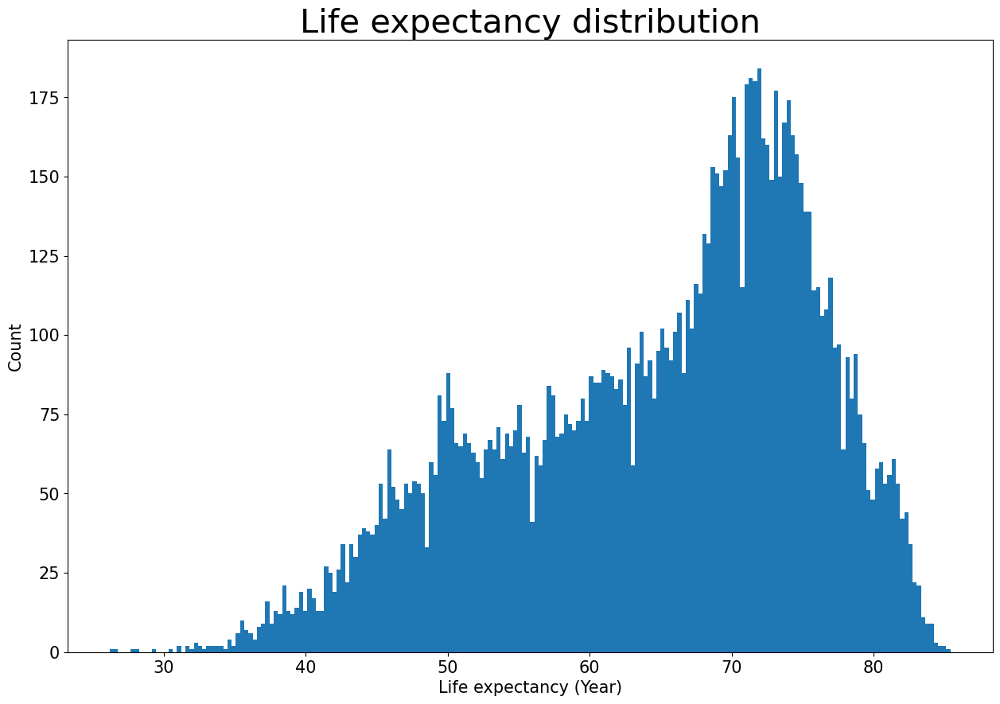

In [39]:
plt.figure(figsize=(15,10))

# round the life expectancy to 1 decimal place to make the plot looks smoother
plt.hist(round(df_clean['Life expectancy at birth, total (years)'],1),bins=200)
plt.title('Life expectancy distribution', fontsize=30)
plt.xlabel('Life expectancy (Year)', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

The graph seems to have a slightly left skewed distribution. This may due to the life expectancy data were collected annually and the annual average may shift to left as the year increase. Let's plot a scatter plot to see the average life expectancy over year.

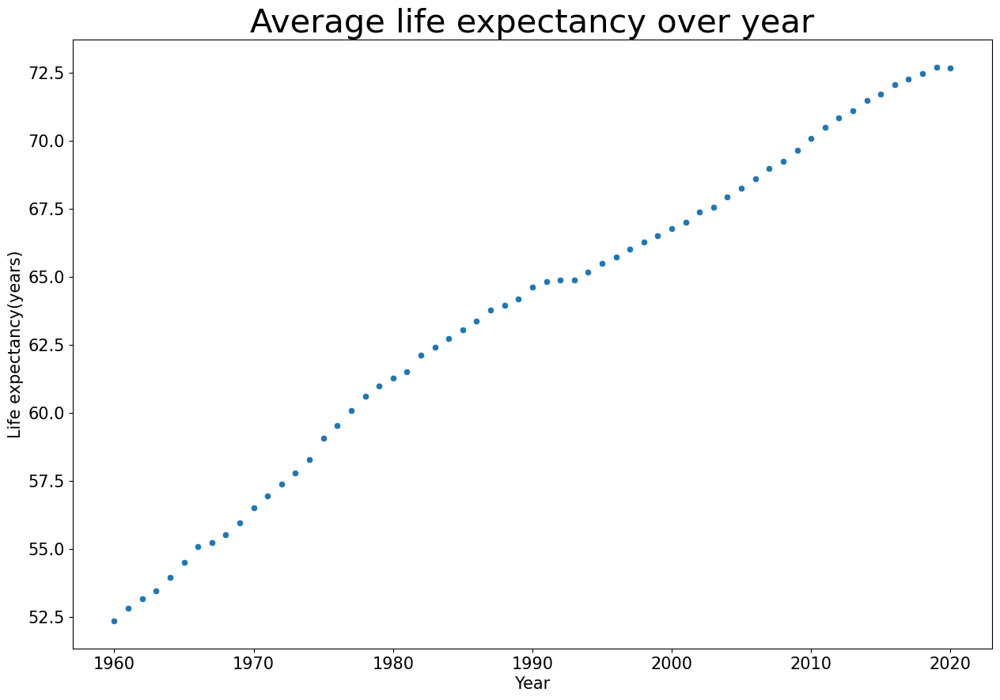

In [40]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=range(1960,2021), y=df_clean['Life expectancy at birth, total (years)'].groupby(df_clean['Year']).mean())
plt.title('Average life expectancy over year', fontsize=30)
plt.xlabel('Year', fontsize=15)
plt.ylabel('Life expectancy(years)', fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

For the past 60 years, the life expectancy increase steady from around 52.5 to over 72.5 ,which has around 40% increase accumulatively.

Next,we can find out which countries has longest and shortest averave life expectancy.

In [41]:
# find out the countries with shortest average life expectancy
df_clean['Life expectancy at birth, total (years)'].groupby(df_clean['Country']).mean().sort_values().head(5)

Country
Sierra Leone    41.197459
Somalia         45.346795
Niger           45.779213
Nigeria         45.920328
Mali            46.111667
Name: Life expectancy at birth, total (years), dtype: float64

In [42]:
df_clean['Life expectancy at birth, total (years)'].groupby(df_clean['Country']).mean().sort_values(ascending= False).head(5) 

Country
Cayman Islands      82.190244
Liechtenstein       80.628143
Faroe Islands       80.439767
Macao SAR, China    80.218231
Channel Islands     79.652600
Name: Life expectancy at birth, total (years), dtype: float64

In [43]:
# create the list of the life expectancy of top/bottom 5 countries 
life_exp = [82.190244,80.628143,80.439767,80.218231,79.652600,46.111667,45.920328,45.779213,45.346795,41.197459]
country_list = ['Cayman Islands', 'Liechtenstein', 'Faroe Islands', 'Macao SAR, China', 'Channel Islands', 'Mali', 'Nigeria', 'Niger','Somalia', 'Sierra Leone']

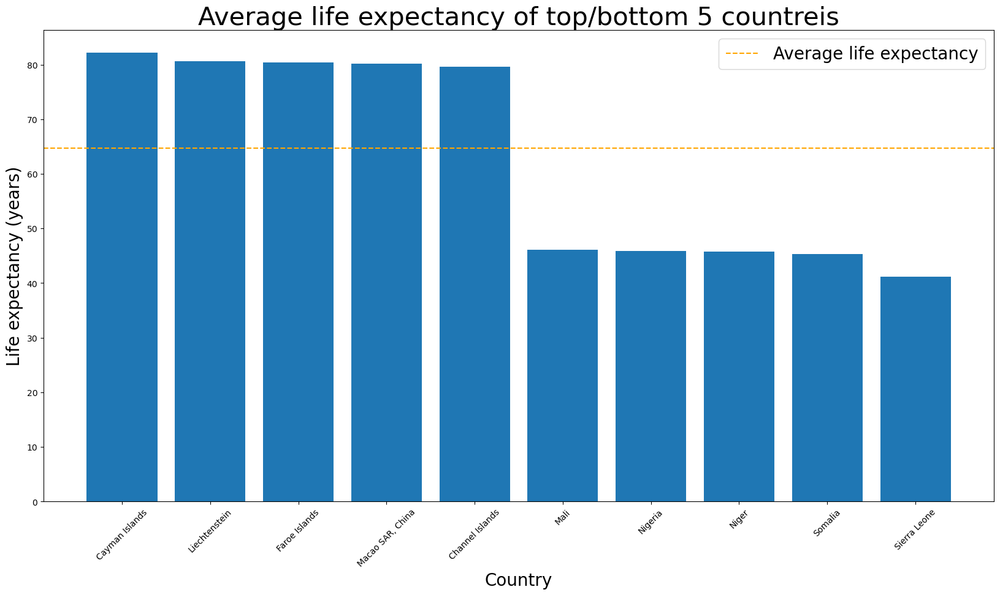

In [44]:
plt.figure(figsize= (20,10))
plt.xticks(rotation=45)
plt.bar(height = life_exp, x = country_list)
plt.axhline(df_clean['Life expectancy at birth, total (years)'].mean(), color='orange', ls='--', label='Average life expectancy')
plt.title('Average life expectancy of top/bottom 5 countreis', fontsize=30)
plt.xlabel('Country', fontsize=20)
plt.ylabel('Life expectancy (years)', fontsize=20)
plt.legend(fontsize=20)
plt.show()

The countries with shortest average life expectancy seems to be all African countries.
For the countries with highest average life expectancy, they seem to have no geographic relationship with each other, but they seem to be wealthy countries.

Let' find out the GDP per capita group of those countries.

In [45]:
# Year 1960 
df_clean[(df_clean['Country'].isin(country_list)) & (df_clean['Year'] == 1960)][['Country','GDP per capita group']]

,Country,GDP per capita group
8287,Niger,low_2
8348,Nigeria,low_2
9833,Sierra Leone,low_2
10120,Somalia,low_2


In [46]:
# Year 1980
df_clean[(df_clean['Country'].isin(country_list)) & (df_clean['Year'] == 1980)][['Country','GDP per capita group']]

,Country,GDP per capita group
7186,Mali,low_1
8307,Niger,mid-low_2
8368,Nigeria,mid-low_1
9853,Sierra Leone,low_1
10140,Somalia,low_2


In [47]:
# Year 2000
df_clean[(df_clean['Country'].isin(country_list)) & (df_clean['Year'] == 2000)][['Country','GDP per capita group']]

,Country,GDP per capita group
2019,Channel Islands,high_1
3668,Faroe Islands,high_1
6627,Liechtenstein,high_1
6928,"Macao SAR, China",high_2
7206,Mali,low_1
8327,Niger,low_2
8388,Nigeria,mid-low_2
9873,Sierra Leone,low_2


In [48]:
# Year 2020
df_clean[(df_clean['Country'].isin(country_list)) & (df_clean['Year'] == 2020)][['Country','GDP per capita group']]

,Country,GDP per capita group
3688,Faroe Islands,high_1
6948,"Macao SAR, China",high_1
7226,Mali,mid-low_1
8347,Niger,mid-low_2
8408,Nigeria,mid_1
9893,Sierra Leone,mid-low_2
10158,Somalia,mid-low_2


Seems the countries from the top 5 life expectancy are from wealthy countries, which they are group of high_1 and group_2(the top 20% weathy countries) and the bottom 5 are from less weathy country as their GDP group are from mid-low_1 to low_2(the least 40% weathy countries).

Let plot a boxplot to see the life expectancy of different GDP per capita group.

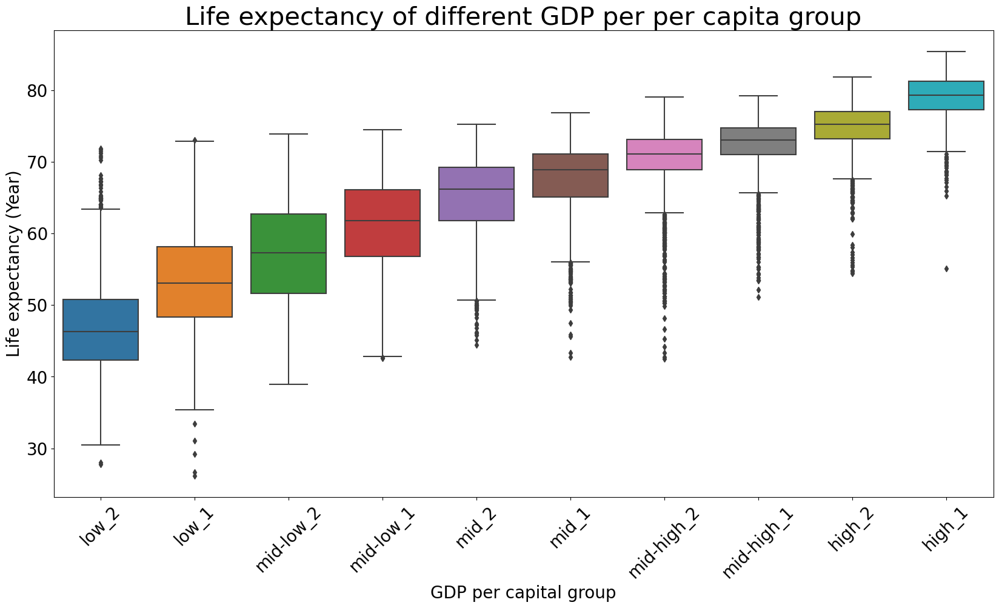

In [49]:
plt.figure(figsize=(20,10))

sns.boxplot(y= df_clean['Life expectancy at birth, total (years)'], x=df_clean['GDP per capita group'])
plt.title('Life expectancy of different GDP per per capita group', fontsize=30)
plt.xticks(rotation=45, fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel("GDP per capital group", fontsize=20)
plt.ylabel('Life expectancy (Year)', fontsize=20)
plt.show()

From the boxplot above, it shows that the group with higher GDP per capita usually have higher life expectancy, but there are some outliners that are observed for the top 60% GDP per capita group that they have lower life expectancy then their group. Also, the group of the lowest GDP per capita has some outliners that higher life expectancy then its group.

Let's have a loser look at how each column on how it affects on the life expectancy.

In [50]:
X = df_clean.drop('Life expectancy at birth, total (years)',axis =1)
y = df_clean['Life expectancy at birth, total (years)']

In [51]:
# The run time may be little long
plt.subplots(86,3, figsize=(30,258*2))

count = 1

for col in X.columns:
    plt.subplot(86,3,count)
    plt.scatter(X[col],y)
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

Alternatively, you can have a bigger scatter plot by copy the following code and run it in a code cell.

    for i in range(len(X_train.columns)):
        plt.figure(figsize=(10,500))
        plt.subplot(len(X.columns),1,i+1)
        sns.scatterplot(x=X_train[X_train.columns[i]],y=y)
        plt.show()

From the above graph, there some columns have a visible linear pattern, some have non-linear relationship and some do not have a visible relationship with with the life expectancy.

With a visible linear relationship:

- Year
- Death rate
- Mortality rate
- Rural/urban population
- Life expectancy of male/female (which is reasonable as life expectancy is calculated by the weighted average of those columns)
etc.

With non-linear relathionship:

- Adjusted net national income(per capira)
- Age dependency ratio (Old and young)
- Fertility rate
- Agriculture, forestry, and fishing, value added
- CO2 emissions
- Population ages
etc.

Without a visible relationship:

- External balance on goods and services
- Food imports
- GDP growth
etc.

## <a id='select'>Feature selection</a>

Although the data is good to go for modeling, there are some columns that are used to calculate the life expectancy, which are `Life expectancy at birth, female (years)` and `Life expectancy at birth, male (years)`, I will to remove these columns to prevent the model have abnormal high prediction power.

In [52]:
df_modeling = df_clean.drop(['Life expectancy at birth, female (years)', 'Life expectancy at birth, male (years)'],axis=1)

Also, I want to remove the columns that are related to age as those columns are probably are used to calculate the life expectancy so that my model can focus on how the environmental factors affect the life expectancy.

The columns are:

- `Survival to age 65, female (% of cohort)` and `Survival to age 65, male (% of cohort)`,
- Columns related to `Mortality rate`,
- Columns related to `Death rate`,
- Columns related to `Population ages`

In [53]:
df_modeling = df_modeling.drop(['Survival to age 65, female (% of cohort)', 'Survival to age 65, male (% of cohort)'],axis=1)

In [54]:
# Find out columns that related to mortality rate
mortality_col = df_modeling.columns[df_modeling.columns.str.startswith('Mortality')]
mortality_col

Index(['Mortality rate, adult, female (per 1,000 female adults)',
       'Mortality rate, adult, male (per 1,000 male adults)',
       'Mortality rate, infant (per 1,000 live births)',
       'Mortality rate, infant, female (per 1,000 live births)',
       'Mortality rate, infant, male (per 1,000 live births)',
       'Mortality rate, neonatal (per 1,000 live births)',
       'Mortality rate, under-5 (per 1,000 live births)',
       'Mortality rate, under-5, female (per 1,000 live births)',
       'Mortality rate, under-5, male (per 1,000 live births)'],
      dtype='object')

In [55]:
# remove those columns
df_modeling = df_modeling.drop(mortality_col,axis=1)

In [56]:
# Find out columns that related to death rate
death_col = df_modeling.columns[df_modeling.columns.str.startswith('Death')]
death_col

Index(['Death rate, crude (per 1,000 people)'], dtype='object')

In [57]:
# remove those columns
df_modeling = df_modeling.drop(death_col,axis=1)

In [58]:
# Find out columns that related to population
population_col = df_modeling.columns[df_modeling.columns.str.startswith('Population')]
population_col

Index(['Population ages 00-04, female (% of female population)',
       'Population ages 00-04, male (% of male population)',
       'Population ages 0-14 (% of total population)',
       'Population ages 0-14, female',
       'Population ages 0-14, female (% of female population)',
       'Population ages 0-14, male',
       'Population ages 0-14, male (% of male population)',
       'Population ages 0-14, total',
       'Population ages 05-09, female (% of female population)',
       'Population ages 05-09, male (% of male population)',
       'Population ages 10-14, female (% of female population)',
       'Population ages 10-14, male (% of male population)',
       'Population ages 15-19, female (% of female population)',
       'Population ages 15-19, male (% of male population)',
       'Population ages 15-64 (% of total population)',
       'Population ages 15-64, female',
       'Population ages 15-64, female (% of female population)',
       'Population ages 15-64, male',
    

In [59]:
# remove those columns
df_modeling = df_modeling.drop(population_col,axis=1)

Finally, I will remove the non-numeric column(`Country`) and the columns that are used to fill in the missing values(`GDP per capita rank` and `GDP per capita group`)

In [60]:
df_model = df_modeling.drop(['Country','GDP per capita rank', 'GDP per capita group'],axis=1)

In [61]:
df_model.head()

,Year,Adjusted net national income (current US$),Adjusted net national income per capita (current US$),Adjusted savings: carbon dioxide damage (% of GNI),Adjusted savings: carbon dioxide damage (current US$),Adjusted savings: consumption of fixed capital (% of GNI),Adjusted savings: education expenditure (% of GNI),Adjusted savings: energy depletion (% of GNI),Adjusted savings: energy depletion (current US$),Adjusted savings: mineral depletion (% of GNI),...,"Services, value added (current US$)",Surface area (sq. km),Total fisheries production (metric tons),Total natural resources rents (% of GDP),Trade (% of GDP),Urban population,Urban population (% of total population),Urban population growth (annual %),Women Business and the Law Index Score (scale 1-100),"Life expectancy at birth, total (years)"
0,1960,2.555136e+09,140.263169,0.443165,5232039.895,7.046906,2.3,0.000866,0.0,0.001334,...,5.121335e+08,637660.0,200.0,6.751792,11.157027,755835.0,8.401,4.597999,43.4375,32.446
1,1961,2.555136e+09,140.263169,0.443165,5232039.895,7.046906,2.3,0.000866,0.0,0.001334,...,5.121335e+08,652860.0,300.0,6.751792,12.550610,796271.0,8.684,5.211648,43.4375,32.962
2,1962,2.555136e+09,140.263169,0.443165,5232039.895,7.046906,2.3,0.000866,0.0,0.001334,...,5.121335e+08,652860.0,300.0,6.751792,14.227644,839385.0,8.976,5.272990,43.4375,33.471
3,1963,2.555136e+09,140.263169,0.443165,5232039.895,7.046906,2.3,0.000866,0.0,0.001334,...,5.121335e+08,652860.0,300.0,6.751792,26.035511,885227.0,9.276,5.317463,43.4375,33.971
4,1964,2.555136e+09,140.263169,0.443165,5232039.895,7.046906,2.3,0.000866,0.0,0.001334,...,5.121335e+08,652860.0,300.0,6.751792,26.944448,934134.0,9.586,5.377579,43.4375,34.463


In [62]:
# check the size of the data frame
print(f"The model has {df_model.shape[0]} rows and {df_model.shape[1]} column.")

The model has 12330 rows and 180 column.


Now Let's start to build the first model.

First, I have to split the data set to train set(to build the model), validation set(for hyperparameter optimization) and test set(to get unbiased accuracy score).

As the data is collected yearly for each country. Even though I don't treat it as a time series problem, I still don't want to build a model base on new data to predict the old data as the new data may have some predicting power for the past data. 

I will use the latest 20% of data as the test set. Then I will use the oldest 70% of data from the remainder as train set and the rest of remainder will be the validation set.

In [63]:
# sort the data frame by year
df_model = df_model.sort_values(by='Year')

# reset index
df_model.reset_index(inplace= True, drop = True)

Now I will define the dependent and independents for the model.

In [64]:
X = df_model.drop('Life expectancy at birth, total (years)',axis=1)
y = df_model['Life expectancy at birth, total (years)']

In [65]:
# split the data frame to remainder and test set
from sklearn.model_selection import train_test_split

# set shuffle to False to make sure the test data are more reacent than the reminder data
X_remainder, X_test, y_remainder, y_test = train_test_split(X, y, test_size = 0.2, shuffle = False)

In [66]:
# reset index
X_remainder.reset_index(inplace = True, drop = True)
X_test.reset_index(inplace = True, drop = True)
y_remainder.reset_index(inplace = True, drop = True)
y_test.reset_index(inplace = True, drop = True)

Then split a validation set from the remainder set to optimize the hyperparameters. Same as before, I will use the old data as train set and new data as validation set.

In [67]:
# split the remainder set to train and validation set(set shuffle to False)
X_train, X_validation, y_train, y_validation = train_test_split(X_remainder, y_remainder, test_size = 0.3, shuffle = False)

In [68]:
# reset index
X_train.reset_index(inplace = True, drop = True)
X_validation.reset_index(inplace = True, drop = True)
y_train.reset_index(inplace = True, drop = True)
y_validation.reset_index(inplace = True, drop = True)

## <a id ='linear'>Linear regression model</a>

To build a linear regression model, I will determine the features multicollinearity of different features.

Let's look at the variance of the features.

In [69]:
X_train.var().sort_values(ascending= False)

GDP (constant LCU)                                               1.893621e+29
GDP (current LCU)                                                9.561592e+26
GNI (current LCU)                                                9.469400e+26
GDP (constant 2015 US$)                                          1.374825e+25
Gross national expenditure (current US$)                         4.800700e+24
                                                                     ...     
Lower secondary school starting age (years)                      4.736845e-01
Primary education, duration (years)                              4.549552e-01
Primary school starting age (years)                              2.299344e-01
Arable land (hectares per person)                                7.570012e-02
School enrollment, primary (gross), gender parity index (GPI)    2.294033e-02
Length: 179, dtype: float64

As the columns have different values from single digit to millions or more, let's will look at the scaled variance.

In [70]:
# scale the data by standard scaler as the data may have a lot of outliners
from sklearn.preprocessing import StandardScaler

std_scaler = StandardScaler()
scaled_data = std_scaler.fit_transform(X_train)

X_train_scaled = pd.DataFrame(data=scaled_data, columns=X_train.columns)

X_train_scaled.var().sort_values(ascending= False)

Mobile cellular subscriptions (per 100 people)                   1.000145
Adjusted savings: energy depletion (current US$)                 1.000145
Adjusted savings: energy depletion (% of GNI)                    1.000145
Agricultural raw materials exports (% of merchandise exports)    1.000145
Manufactures exports (% of merchandise exports)                  1.000145
                                                                   ...   
Manufactures imports (% of merchandise imports)                  1.000145
Adjusted savings: mineral depletion (current US$)                1.000145
Primary education, duration (years)                              1.000145
Primary school starting age (years)                              1.000145
Oil rents (% of GDP)                                             1.000145
Length: 179, dtype: float64

Seems the variance of the features are similar after scaling, this may due to the method of fill in missing data or coincidence as some columns don't have missing values to fill in. In this case, I am not able to select features from the variance analysis.

Then I will look for the multicollinearity of each feature by calculating the variance inflation factor(VIF).

In [71]:
# As there are some columns may have 0 in some rows, I will add a small number to each data cell to prevent the divided by zero problem
X_train_mod = X_train + 0.0001

In [72]:
# Calculate VIF
# This may need a longer time to run
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor


# add contstant to calculate VIF
X_train_const = sm.add_constant(X_train_mod)

life_vif = pd.Series([variance_inflation_factor(X_train_const.values, i) 
               for i in range(X_train_const.values.shape[1])], 
              index=X_train_const.columns)[1:]

In [73]:
life_vif.sort_values()

Year                                                                 1.121391e-01
Monetary Sector credit to private sector (% GDP)                     1.028791e+00
Agriculture, forestry, and fishing, value added (annual % growth)    1.129043e+00
Foreign direct investment, net inflows (% of GDP)                    1.233078e+00
Rural population growth (annual %)                                   1.290908e+00
                                                                         ...     
Surface area (sq. km)                                                9.476464e+04
Land area (sq. km)                                                   9.824359e+04
Aquaculture production (metric tons)                                 4.106857e+05
Capture fisheries production (metric tons)                           3.451823e+06
Total fisheries production (metric tons)                             5.638972e+06
Length: 179, dtype: float64

Seems there some features have very high VIF, which means they have high multicollinearity with other features. In this case, I will only select features with VIF less than 5.

In [74]:
# make a list that has all the names have VIF less than 5
col_list = []
for i in life_vif[life_vif<5].index:
    col_list.append(i)

In [75]:
len(col_list)

54

In [76]:
# make new data frame for train, validation and test sets
X_train_lin = X_train[col_list]
X_validation_lin = X_validation[col_list]
X_test_lin = X_test[col_list]

For the remaining features, let's visualize the correlation of each feature to other features by heat map.

In [77]:
# calculate orrelation between independent variables
X_test_lin_corr = X_train_lin.corr()
X_test_lin_corr

,Year,Adjusted savings: carbon dioxide damage (% of GNI),Adjusted savings: carbon dioxide damage (current US$),Adjusted savings: consumption of fixed capital (% of GNI),Adjusted savings: education expenditure (% of GNI),Adjusted savings: energy depletion (current US$),Adjusted savings: mineral depletion (current US$),Agricultural land (% of land area),Agricultural raw materials exports (% of merchandise exports),Agricultural raw materials imports (% of merchandise imports),...,Net ODA received per capita (current US$),Ores and metals imports (% of merchandise imports),Permanent cropland (% of land area),"Primary education, duration (years)",Primary school starting age (years),Rural population growth (annual %),"Secondary education, duration (years)","Services, value added (% of GDP)",Urban population growth (annual %),Women Business and the Law Index Score (scale 1-100)
Year,1.000000,0.145475,0.130333,0.285947,0.198755,0.077614,0.100118,0.026045,-0.312035,-0.210957,...,0.151477,-0.048561,0.098795,-0.167286,0.092442,-0.067622,0.149810,0.261827,-0.283695,0.285157
Adjusted savings: carbon dioxide damage (% of GNI),0.145475,1.000000,0.061123,0.146736,0.045899,0.025192,0.027844,0.016824,-0.045387,-0.012948,...,-0.011304,0.004892,-0.041496,-0.179263,0.063837,0.000840,0.042093,-0.073922,-0.096753,0.013751
Adjusted savings: carbon dioxide damage (current US$),0.130333,0.061123,1.000000,0.194151,0.038651,0.670281,0.539736,0.056103,-0.072767,0.037290,...,-0.035315,0.109937,-0.047773,-0.116389,0.048322,-0.035023,0.030612,0.105536,-0.124028,0.199473
Adjusted savings: consumption of fixed capital (% of GNI),0.285947,0.146736,0.194151,1.000000,0.174108,0.114941,0.156178,0.018796,-0.223025,0.071901,...,-0.019266,0.286555,-0.093791,-0.226196,0.094635,-0.077597,0.187549,0.273043,-0.360250,0.373286
Adjusted savings: education expenditure (% of GNI),0.198755,0.045899,0.038651,0.174108,1.000000,0.048381,0.072566,-0.028358,-0.175188,-0.053773,...,0.086839,0.047846,0.106008,0.073532,-0.027582,-0.029242,0.008578,0.246109,-0.202540,0.241526
Adjusted savings: energy depletion (current US$),0.077614,0.025192,0.670281,0.114941,0.048381,1.000000,0.462649,0.008310,-0.065997,-0.018310,...,-0.038256,0.045941,-0.060201,-0.043663,0.020151,-0.005933,-0.012928,0.056039,-0.036811,0.066435
Adjusted savings: mineral depletion (current US$),0.100118,0.027844,0.539736,0.156178,0.072566,0.462649,1.000000,0.019276,-0.033492,-0.014697,...,-0.023764,0.038722,-0.067277,0.000483,0.056771,-0.009706,-0.082064,0.101624,-0.094782,0.134357
Agricultural land (% of land area),0.026045,0.016824,0.056103,0.018796,-0.028358,0.008310,0.019276,1.000000,-0.015250,0.157653,...,-0.142351,0.110848,0.149391,-0.109110,0.055499,0.027520,0.124766,-0.071590,-0.053904,0.022205
Agricultural raw materials exports (% of merchandise exports),-0.312035,-0.045387,-0.072767,-0.223025,-0.175188,-0.065997,-0.033492,-0.015250,1.000000,-0.034174,...,-0.106418,-0.139387,-0.076924,0.053129,0.078388,0.091626,-0.066314,-0.268119,0.239401,-0.207605
Agricultural raw materials imports (% of merchandise imports),-0.210957,-0.012948,0.037290,0.071901,-0.053773,-0.018310,-0.014697,0.157653,-0.034174,1.000000,...,-0.086734,0.651924,0.023338,-0.047884,-0.036287,-0.086857,0.015172,0.065463,-0.176350,0.074869


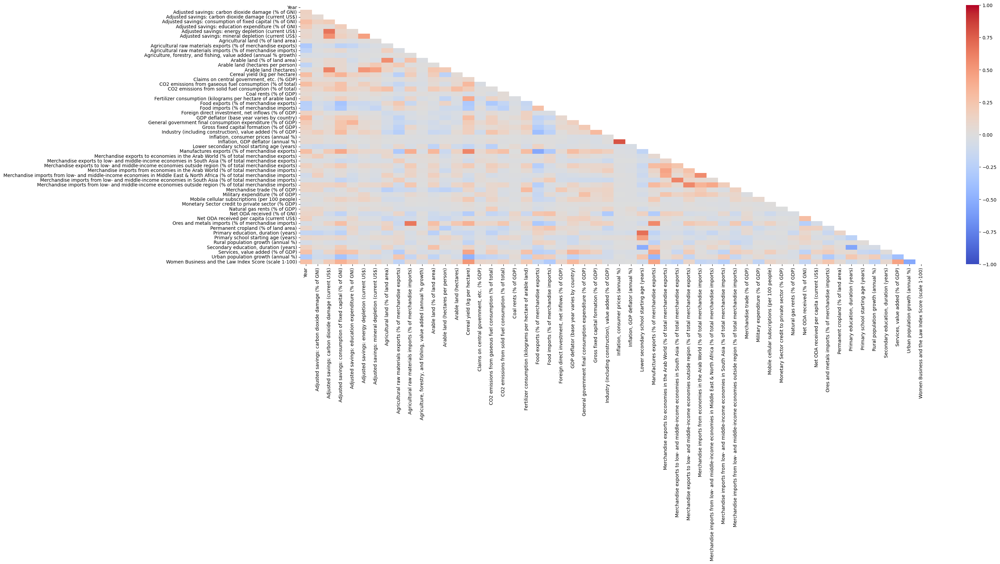

In [78]:
# Correlation of the variables in a heatmap
plt.figure(figsize=(30,10))
matrix = np.triu(X_train_lin.corr())
sns.heatmap(X_train_lin.corr(), mask=matrix, cmap='coolwarm', vmin = -1, vmax = 1)
plt.show()

Although heat map is not a good visualization for correlation of large amount of features, let's see that most of the features do not have high correlation with other features.

Now I will build a linear model by selecting the n best features with highest accarcy score.

In [79]:
# import statsmodels linear model for our regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.linear_model import LinearRegression

In [80]:
train_scores = []
validation_scores = []


n_best = list(range(1,len(col_list))) # number of features

for n in n_best:
    
    my_n_best = SelectKBest(f_regression,k=n).fit(X_train_lin,y_train)
    
    X_train_selected = my_n_best.transform(X_train_lin)
    X_validation_selected = my_n_best.transform(X_validation_lin)
    
    model = LinearRegression()
    
    # fit model
    model.fit(X_train_selected,y_train)
    
    print(f"n_best = {n}, {X_train_lin.columns[my_n_best.get_support()]}")
    
    # socre model
    train_scores.append(model.score(X_train_selected,y_train))
    validation_scores.append(model.score(X_validation_selected,y_validation))

n_best = 1, Index(['Cereal yield (kg per hectare)'], dtype='object')
n_best = 2, Index(['Cereal yield (kg per hectare)', 'Manufactures exports (% of merchandise exports)'], dtype='object')
n_best = 3, Index(['Cereal yield (kg per hectare)',
       'Manufactures exports (% of merchandise exports)',
       'Urban population growth (annual %)'],
      dtype='object')
n_best = 4, Index(['Cereal yield (kg per hectare)',
       'Manufactures exports (% of merchandise exports)',
       'Services, value added (% of GDP)',
       'Urban population growth (annual %)'],
      dtype='object')
n_best = 5, Index(['Cereal yield (kg per hectare)',
       'Manufactures exports (% of merchandise exports)',
       'Services, value added (% of GDP)',
       'Urban population growth (annual %)',
       'Women Business and the Law Index Score (scale 1-100)'],
      dtype='object')
n_best = 6, Index(['Adjusted savings: consumption of fixed capital (% of GNI)',
       'Cereal yield (kg per hectare)',
       '

n_best = 21, Index(['Year', 'Adjusted savings: consumption of fixed capital (% of GNI)',
       'Adjusted savings: education expenditure (% of GNI)',
       'Agricultural raw materials exports (% of merchandise exports)',
       'Cereal yield (kg per hectare)',
       'CO2 emissions from gaseous fuel consumption (% of total)',
       'Fertilizer consumption (kilograms per hectare of arable land)',
       'Food exports (% of merchandise exports)',
       'Food imports (% of merchandise imports)',
       'GDP deflator (base year varies by country)',
       'General government final consumption expenditure (% of GDP)',
       'Gross fixed capital formation (% of GDP)',
       'Industry (including construction), value added (% of GDP)',
       'Manufactures exports (% of merchandise exports)',
       'Merchandise exports to low- and middle-income economies outside region (% of total merchandise exports)',
       'Merchandise imports from low- and middle-income economies outside region (% o

n_best = 37, Index(['Year', 'Adjusted savings: carbon dioxide damage (current US$)',
       'Adjusted savings: consumption of fixed capital (% of GNI)',
       'Adjusted savings: education expenditure (% of GNI)',
       'Adjusted savings: energy depletion (current US$)',
       'Adjusted savings: mineral depletion (current US$)',
       'Agricultural raw materials exports (% of merchandise exports)',
       'Agricultural raw materials imports (% of merchandise imports)',
       'Arable land (hectares per person)', 'Cereal yield (kg per hectare)',
       'CO2 emissions from gaseous fuel consumption (% of total)',
       'CO2 emissions from solid fuel consumption (% of total)',
       'Fertilizer consumption (kilograms per hectare of arable land)',
       'Food exports (% of merchandise exports)',
       'Food imports (% of merchandise imports)',
       'Foreign direct investment, net inflows (% of GDP)',
       'GDP deflator (base year varies by country)',
       'General government fi

n_best = 50, Index(['Year', 'Adjusted savings: carbon dioxide damage (% of GNI)',
       'Adjusted savings: carbon dioxide damage (current US$)',
       'Adjusted savings: consumption of fixed capital (% of GNI)',
       'Adjusted savings: education expenditure (% of GNI)',
       'Adjusted savings: energy depletion (current US$)',
       'Adjusted savings: mineral depletion (current US$)',
       'Agricultural land (% of land area)',
       'Agricultural raw materials exports (% of merchandise exports)',
       'Agricultural raw materials imports (% of merchandise imports)',
       'Agriculture, forestry, and fishing, value added (annual % growth)',
       'Arable land (% of land area)', 'Arable land (hectares per person)',
       'Arable land (hectares)', 'Cereal yield (kg per hectare)',
       'Claims on central government, etc. (% GDP)',
       'CO2 emissions from gaseous fuel consumption (% of total)',
       'CO2 emissions from solid fuel consumption (% of total)',
       'Fertil

Let's visiualize the best n features and the accuracy score for the train and validation set.

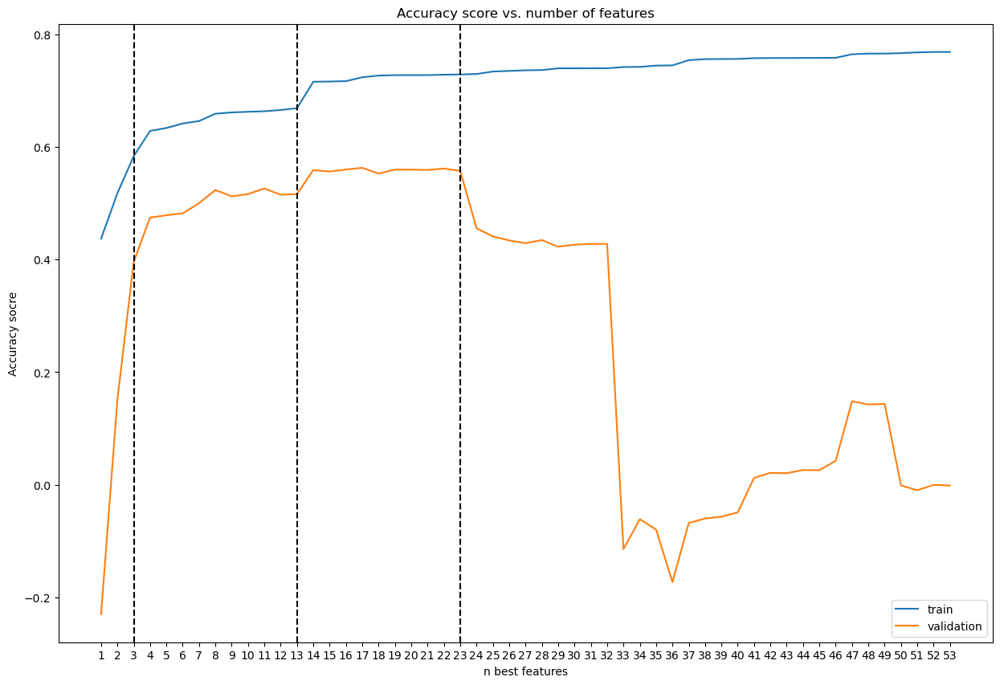

In [81]:
plt.figure(figsize=(15,10))
plt.plot(n_best,train_scores,label = 'train')
plt.plot(n_best,validation_scores,label = 'validation')
plt.xticks(n_best)
plt.xlabel("n best features")
plt.ylabel("Accuracy socre")
plt.title("Accuracy score vs. number of features")
plt.axvline(3, color='black',  ls='--')
plt.axvline(13, color='black',  ls='--')
plt.axvline(23, color='black',  ls='--')
plt.legend()
plt.show()

From the above plot, the accuracy score for validation increases rapidly to 0.4 when n is not larger than 3 and slowly increase to around 0.5 from n is between 3 to 23. Then the accuracy score starts to decrease when more features are added to the model.

Also, the model is always overfitting as there are a difference on the accuracy score between train set and validation set. The model with less over fitting is when n best feawtures between 3 to 13.

Let's try to build a model with the top 10 best features.

In [82]:
best_10 = ['Year', 'Adjusted savings: consumption of fixed capital (% of GNI)',
       'Agricultural raw materials exports (% of merchandise exports)',
       'Cereal yield (kg per hectare)',
       'Fertilizer consumption (kilograms per hectare of arable land)',
       'Manufactures exports (% of merchandise exports)',
       'Mobile cellular subscriptions (per 100 people)',
       'Net ODA received (% of GNI)', 'Urban population growth (annual %)',
       'Women Business and the Law Index Score (scale 1-100)']

In [83]:
# initiate the model 
lin_model = LinearRegression()

# fit the model
lin_model.fit(X_remainder[best_10], y_remainder)

# score the model
print(f'The accuracy score for remainder set is {lin_model.score(X_remainder[best_10], y_remainder)}')
print(f'The accuracy score for test set is {lin_model.score(X_test[best_10], y_test)}')

The accuracy score for remainder set is 0.6491719204304968
The accuracy score for test set is 0.36602663532936375


Although the model has some prediction power on remainder set, the accuracy score of test set drops to 0.366, which means the model performs similar to predicting the life expectancy by its mean.

Here are the R<sup>2</sup> of the models built so far:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |

## <a id='mod_linear'>Lasso/Ridge model</a>

As the performance of the basic linear regression is not good, I will to build lasso and ridge(linear regression model with regularization) to see if the model can have a better prediction power.

Let's see the performance of the basic lasso and ridge model

In [84]:
from sklearn.linear_model import Lasso, Ridge
lasso_model = Lasso()

lasso_model.fit(X_train, y_train)

print(f'The accuracy score for train set is {lasso_model.score(X_train, y_train)}')
print(f'The accuracy score for validation set is {lasso_model.score(X_validation, y_validation)}')

The accuracy score for train set is 0.9078116168769536
The accuracy score for validation set is -38607556.87527837


In [85]:
ridge_model = Lasso()

ridge_model.fit(X_train, y_train)

print(f'The accuracy score for validation set is {ridge_model.score(X_train, y_train)}')
print(f'The accuracy score for validation set is {ridge_model.score(X_validation, y_validation)}')

The accuracy score for validation set is 0.9078116168769536
The accuracy score for validation set is -38607556.87527837


Seems like both ridge and lasso model does not work well with large amount of features, I will try to use the top features that were found from the linear regression to perform grid search to see which model have better performance and optimize the hyperparameter.

In [86]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
estimators = [
    ('scaling', StandardScaler()),
    ('model', Lasso())
]

# instantiate pipeline
pipe = Pipeline(estimators)

# define parameter grid
param_grid = [
    
    # linear regression lasso regularization
    {
        'scaling': [None, StandardScaler()],
        'model': [Lasso()],
        'model__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000],
    },
    
    # linear regression ridge regularization
    {
        'scaling': [None, StandardScaler()],
        'model': [Ridge()],
        'model__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000],
        'model__random_state':[1]
    }
]

# instantiate cross-validated grid search object with the steps and parameter grid
grid = GridSearchCV(
    estimator = pipe,
    param_grid = param_grid,
    verbose = 5,
    n_jobs = -1
)

# To prevent multicollinearity, I will only use the best 10 features that were found from the linear regression model
fittedgrid = grid.fit(X_train[best_10], y_train)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


In [87]:
fittedgrid.score(X_validation[best_10], y_validation)

0.199287188576458

In [88]:
fittedgrid.best_estimator_

Pipeline(steps=[('scaling', StandardScaler()),
                ('model', Ridge(alpha=1000, random_state=1))])

From the grid search, the best model is ridge with aplha = 100 and scale the data by standard scaler. Let's try to see the perdicting power of the best performance model.

In [89]:
# scale the data
ss = StandardScaler()
ss.fit(X_remainder[best_10])
ss.transform(X_remainder[best_10])
ss.transform(X_test[best_10])

# build model with optimized hypermeter 
ridge_model = Ridge(alpha=1000, random_state = 1)

# fit model
ridge_model.fit(X_remainder[best_10], y_remainder)

# score
print(f'The accuracy score for remainder set is {ridge_model.score(X_remainder[best_10], y_remainder)}')
print(f'The accuracy score for test set is {ridge_model.score(X_test[best_10], y_test)}')

The accuracy score for remainder set is 0.6491401615265922
The accuracy score for test set is 0.36396737422033576


Same as the basic linear model, the ridge model has fair performance on remainder sets, the R<sup>2</sup> drops sharply when predicting the test set. 

Here are the R<sup>2</sup> of the models built so far:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |

Seems the linear regression model does not perform well on predicting life expectancy. Let's try to build some non-linear regression models to see their perdicting power.

## <a id='knn'>KNN regressor model</a>

As the prediction power was not good on linear model, I will to build a non-linear model, which is KNN regressor model.

Let's try to build a basic model with 10 features that were found from the linear model to see its performance.

In [90]:
from sklearn.neighbors import KNeighborsRegressor

# KNN model is scale sensitive, I need to scale the data before modeling
# use standard scaler to prevent the scale drive by outliners
ss = StandardScaler()
ss.fit(X_train[best_10])
ss.transform(X_train[best_10])
ss.transform(X_validation[best_10])


KNN_model = KNeighborsRegressor()

KNN_model.fit(X_train[best_10], y_train)


print(f"Train: {KNN_model.score(X_train[best_10], y_train)}")
print(f"Validation: {KNN_model.score(X_validation[best_10], y_validation)}")

Train: 0.8685670117796546
Validation: 0.6032745638673166


The KNN model seems have a better performance than the linear model, let's can try to build the model with all the features.

In [91]:
ss = StandardScaler()
ss.fit(X_train)
ss.transform(X_train)
ss.transform(X_validation)

KNN_model = KNeighborsRegressor()

KNN_model.fit(X_train, y_train)

print(f"Train: {KNN_model.score(X_train, y_train)}")
print(f"Test: {KNN_model.score(X_validation, y_validation)}")

Train: 0.8680318491972882
Test: 0.22878809148315682


Although the model have better performance on the train set, the accuracy score drops a lot when I put more features into the model. The model with all features seems to learn from the noice of the data. In this case, I will only use 10 features to build the model.

Now I will use the validation set to optimize the n_neighbours the KNN model.

In [92]:
knn_train = []
knn_validation = []

n_range = range(1,102,2)

for n in n_range:
    ss = StandardScaler()
    ss.fit(X_train[best_10])
    ss.transform(X_train[best_10])
    ss.transform(X_validation[best_10])
    
    knn_model = KNeighborsRegressor(n_neighbors= n)
    knn_model.fit(X_train[best_10], y_train)
    
    knn_train.append(knn_model.score(X_train[best_10],y_train))
    knn_validation.append(knn_model.score(X_validation[best_10],y_validation))

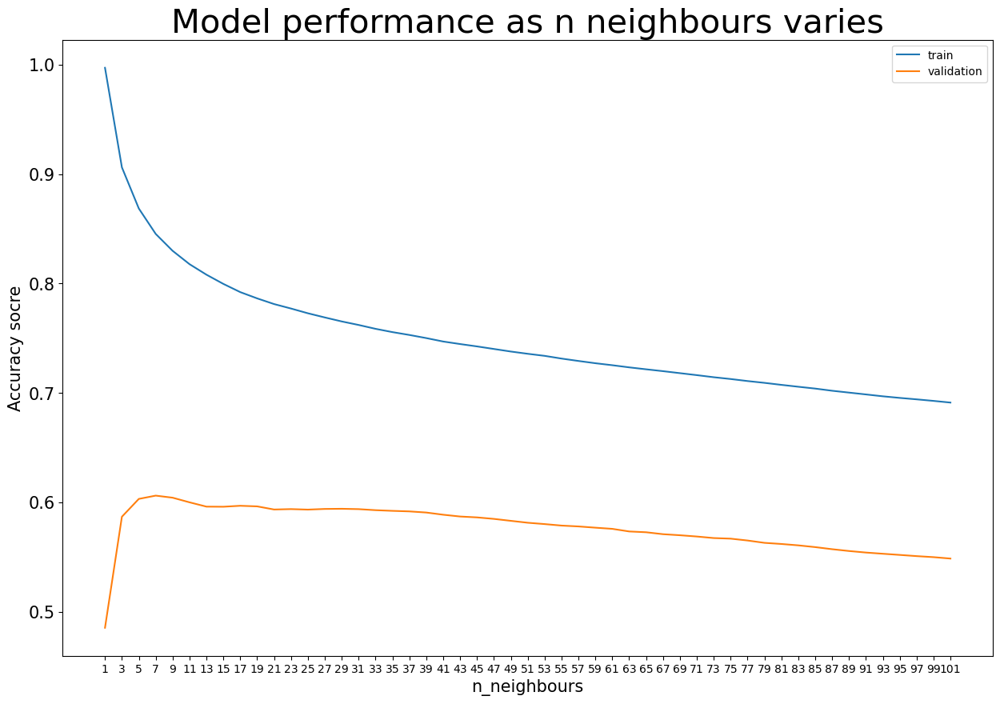

In [93]:
plt.figure(figsize=(15,10))
plt.plot(n_range,knn_train,label = 'train')
plt.plot(n_range,knn_validation,label = 'validation')
plt.xticks(n_range)
plt.xlabel("n_neighbours", fontsize=15)
plt.ylabel("Accuracy socre", fontsize= 15)
plt.title("Model performance as n neighbours varies", fontsize=30)
plt.xticks(fontsize=10)
plt.yticks(fontsize=15)
plt.legend()
plt.show()

From the above plot, the model is always overfitting. The overfitting problem is the worse when n = 1 and then the difference of accuracy score of test and validation become smaller. The difference keeps nearly the same after n is over 21. The optimal n for the model is 21.

Also, the KNN regressor has a hyperparameter called `weights`, I will change it to distance(deafult is uniform) to see its performance.

In [94]:
knn_train = []
knn_validation = []

n_range = range(1,102,2)

for n in n_range:
    ss = StandardScaler()
    ss.fit(X_train[best_10])
    ss.transform(X_train[best_10])
    ss.transform(X_validation[best_10])
    
    knn_model = KNeighborsRegressor(n_neighbors= n, weights='distance')
    knn_model.fit(X_train[best_10], y_train)
    
    knn_train.append(knn_model.score(X_train[best_10],y_train))
    knn_validation.append(knn_model.score(X_validation[best_10],y_validation))

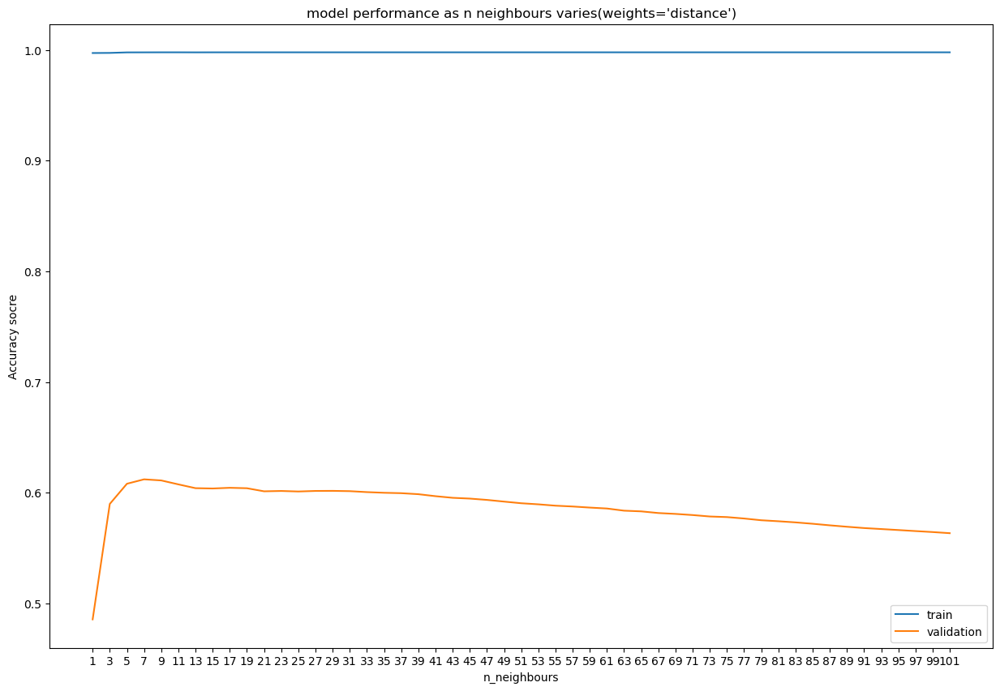

In [95]:
plt.figure(figsize=(15,10))
plt.plot(n_range,knn_train,label = 'train')
plt.plot(n_range,knn_validation,label = 'validation')
plt.xticks(n_range)
plt.xlabel("n_neighbours")
plt.ylabel("Accuracy socre")
plt.title("model performance as n neighbours varies(weights='distance')")
plt.legend()
plt.show()

From the above plot, the accuracy score of validation for weights='distance' is nearly the same as weights='uniform', but the overfitting problem is worse than weights='uniform'.

For my point of view, the test score after the hyperparameter optimization(n_neighbors=23, weights='uniform')

In [96]:
ss = StandardScaler()
ss.fit(X_remainder[best_10])
ss.transform(X_remainder[best_10])
ss.transform(X_test[best_10])


KNN_model_mod = KNeighborsRegressor(n_neighbors=23, weights='uniform')

KNN_model_mod.fit(X_remainder[best_10], y_remainder)

print(f"The accuracy score of remainder set is {KNN_model_mod.score(X_remainder[best_10], y_remainder)}")
print(f"The accuracy score of test set is {KNN_model_mod.score(X_test[best_10], y_test)}")

The accuracy score of remainder set is 0.7851321530759781
The accuracy score of test set is 0.6078383162202905


The best KNN regression model has R<sup>2</sup> of 0.608 and performs better than the linear regression models. I will try to build more non linear regression models and find out which one has the best predicting power.

Here are the R<sup>2</sup> of the models built so far:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |
|KNN regression           | 0.229                       | 0.608                      |

## <a id='svr'>SVR model</a>

Let's look at the SVR model. First I will build a model with 10 features.

In [97]:
from sklearn.svm import SVR

svr_model_10 = SVR()

svr_model_10.fit(X_train[best_10], y_train)

print(f"Train: {svr_model_10.score(X_train[best_10], y_train)}")
print(f"Validation: {svr_model_10.score(X_validation[best_10], y_validation)}")

Train: 0.55701977889607
Validation: 0.42740581856889703


The model has worser performance than the linear and KNN model on the validation set with 10 features, let's build the SVR model with all the features 

In [98]:
svr_model_all = SVR()

svr_model_all.fit(X_train, y_train)

print(f"Train: {svr_model_all.score(X_train, y_train)}")
print(f"Validation: {svr_model_all.score(X_validation, y_validation)}")

Train: 0.006732271817262325
Validation: -0.29867672086258623


Since the model performs worser than the linear and KNN regression model in the validation set, it is expected to have lower accuracy score than KNN model even I optimize the hyperparameter. I will focus on models with higher base accuracy score and then optimize their hyperparameter.

In [99]:
# find the accuracy score of the test set with the best SVR model
svr_model = SVR()

svr_model.fit(X_validation[best_10], y_validation)
print(f"The accuracy score of remainder set is {svr_model.score(X_train[best_10], y_train)}")
print(f"The accuracy score of test set is {svr_model.score(X_test[best_10], y_test)}")

The accuracy score of remainder set is 0.4158217263398717
The accuracy score of test set is 0.4280738177699517


Here are the R<sup>2</sup> of the models built so far:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |
|KNN regression           | 0.229                       | 0.608                      |
|SVR                      | N.A.                        | 0.428                      |

For the KNN regression and SVR model, both of the R<sup>2</sup> for models with all features are lower than models with only 10 features.  In my perspective, this is due to some features has no relationship with the life expectancy, putting it into the model will make it learn the 'wrong' knowledge on how to predict the life expectancy. But real the reason is still uncertain, a further invegestion needs to be done in order to find out the reason.

For now, I will focus on finding model with better predicting power.

## <a id='tree'>Decision tree regression model</a>

First, let's try to build a model with all the features.

In [100]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(random_state= 1)

tree_model.fit(X_train, y_train)

print(tree_model.score(X_train, y_train))
print(tree_model.score(X_validation, y_validation))

1.0
0.7771233319773356


Although the model is overfitting, the accuracy score for the validation set is the highest among the model, I will to adjust the `max_depth` hyperparameter to minimize the over fitting problem.

In [101]:
# build two lists to record the accuracy scores for train and validation
tree_train = []
tree_validation = []

tree_depth = range(1,11)

# write a for loop to get tha accuracy scores of the model on different max_depth
for depth in tree_depth:
    tree_model = DecisionTreeRegressor(max_depth= depth, random_state= 1)
    
    tree_model.fit(X_train, y_train)
    
    tree_train.append(tree_model.score(X_train, y_train))
    tree_validation.append(tree_model.score(X_validation, y_validation))

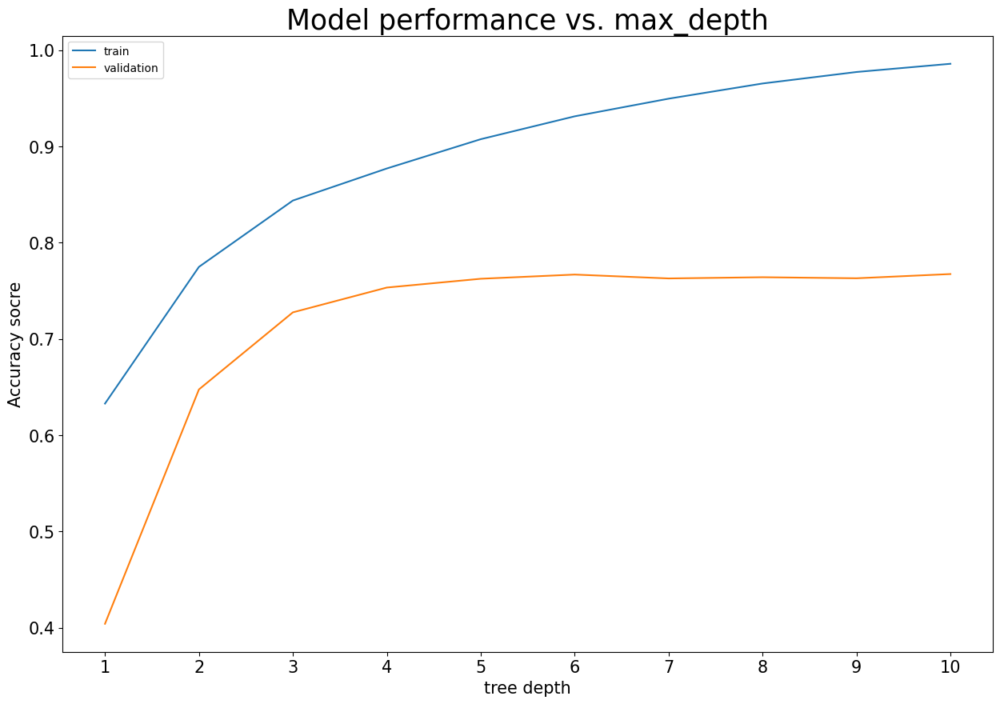

In [102]:
# visualize the accuracy score with different max_depth
plt.figure(figsize=(15,10))
plt.plot(tree_depth,tree_train,label = 'train')
plt.plot(tree_depth,tree_validation,label = 'validation')
plt.xticks(tree_depth, fontsize=15)
plt.xlabel("tree depth", fontsize = 15)
plt.ylabel("Accuracy socre", fontsize = 15)
plt.title("Model performance vs. max_depth", fontsize= 25)
plt.yticks(fontsize=15)
plt.legend()
plt.show()

From the above plot, \the model is less oferfit when the tree depth is less than 5. In this case, I will set the max_depth to 4 to see the accuracy score.

In [103]:
# initiate the model 
tree_model = DecisionTreeRegressor(max_depth=4, random_state= 1)

#  fit the model
tree_model.fit(X_remainder, y_remainder)

# score
print(f"The accuracy score of remainder set is {tree_model.score(X_remainder, y_remainder)}")
print(f"The accuracy score of test set is {tree_model.score(X_test, y_test)}")

The accuracy score of remainder set is 0.8747669364790783
The accuracy score of test set is 0.6702733795913823


As the decision tree is the best model so far, I will  try to build a decision tree model with less features to see how it performs. The decision tree regressor has a function of `feature_importances_` to find out the importance of each feature<sub>[Ref_2](#2)</sub>.

In [104]:
# initiate the model 
model = DecisionTreeRegressor()
# fit the model
model.fit(X_train, y_train)

DecisionTreeRegressor()

In [105]:
# get importance
importance = model.feature_importances_

# get the top 10 most important features(can adjust the number of n_top_features to get the n top n features)
n_top_features = 10
top_features = importance.argsort()[-n_top_features:]
print(np.flip(top_features)) 

[55 32 16 80 51 13 15 52 18 14]


In [106]:
# get the name of features
for i in np.flip(top_features):
    print(f"'{X_train.columns[i]}',")

'Fixed telephone subscriptions (per 100 people)',
'Birth rate, crude (per 1,000 people)',
'Age dependency ratio, young (% of working-age population)',
'GNI per capita, Atlas method (current US$)',
'Fertility rate, total (births per woman)',
'Adolescent fertility rate (births per 1,000 women ages 15-19)',
'Age dependency ratio, old (% of working-age population)',
'Fertilizer consumption (kilograms per hectare of arable land)',
'Agricultural land (sq. km)',
'Age dependency ratio (% of working-age population)',


In [107]:
# create a list for top 10 important features
tree_10 = ['Fixed telephone subscriptions (per 100 people)',
'Birth rate, crude (per 1,000 people)',
'Age dependency ratio, young (% of working-age population)',
'GNI per capita, Atlas method (current US$)',
'Fertility rate, total (births per woman)',
'Adolescent fertility rate (births per 1,000 women ages 15-19)',
'Age dependency ratio, old (% of working-age population)',
'Age dependency ratio (% of working-age population)',
'Fertilizer consumption (kilograms per hectare of arable land)',
    'Agricultural land (sq. km)']

Let's optimize the max_depth again with the top 10 features model.

In [108]:
# list for recording the accuracy score of train and validation set
tree_train = []
tree_validation = []

tree_depth = range(1,11)

for depth in tree_depth:
    tree_model = DecisionTreeRegressor(max_depth= depth)
    
    tree_model.fit(X_train[tree_10], y_train)
    
    tree_train.append(tree_model.score(X_train[tree_10], y_train))
    tree_validation.append(tree_model.score(X_validation[tree_10], y_validation))

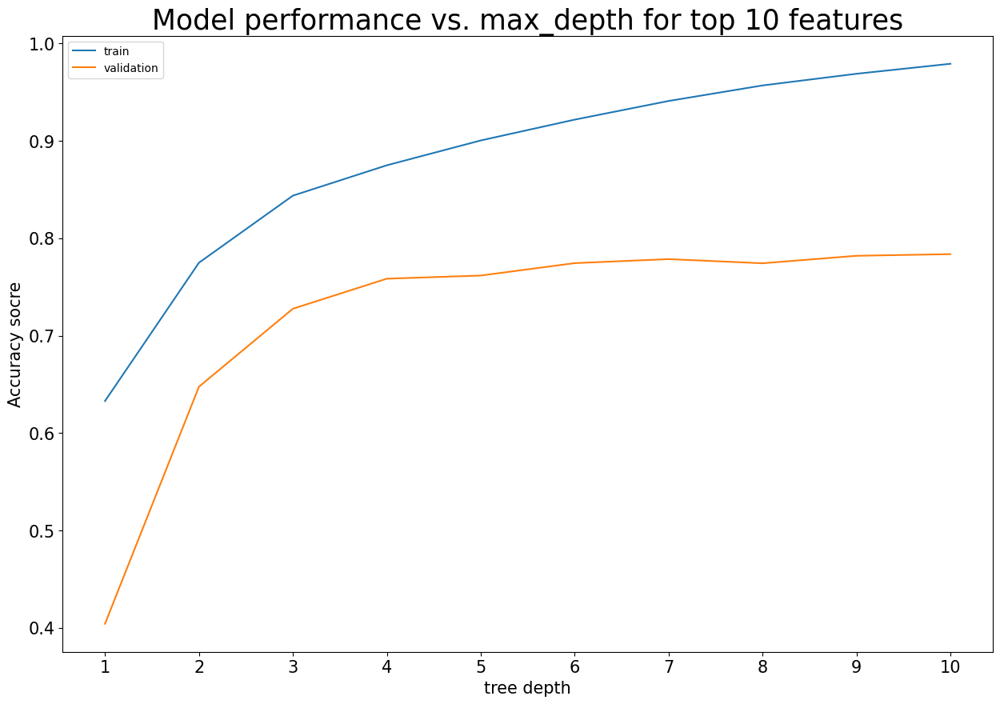

In [109]:
# visualize the accuracy score with different max_depth
plt.figure(figsize=(15,10))
plt.plot(tree_depth,tree_train,label = 'train')
plt.plot(tree_depth,tree_validation,label = 'validation')
plt.xticks(tree_depth)
plt.xlabel("tree depth", fontsize = 15)
plt.ylabel("Accuracy socre", fontsize =15)
plt.title("Model performance vs. max_depth for top 10 features", fontsize = 25)
plt.xticks(fontsize= 15)
plt.yticks(fontsize= 15)
plt.legend()
plt.show()

From the above graph, the model has smaller overfitting problem when the max_depth is less than 5. In this case, I will build a model with max_depth of 4.

In [110]:
from sklearn.tree import DecisionTreeRegressor

tree_model = DecisionTreeRegressor(max_depth=4, random_state= 1)

tree_model.fit(X_remainder[tree_10], y_remainder)


print(f"The accuracy socre of remainder set is {tree_model.score(X_remainder[tree_10], y_remainder)}")
print(f"The accuracy socre of test set is {tree_model.score(X_test[tree_10], y_test)}")

The accuracy socre of remainder set is 0.8672544543205193
The accuracy socre of test set is 0.6752929039072031


Although the decision tree model has relative good performance among all models so far, it still has some overfitting problem and I still want to find a model with better prediction power.


Here are the R<sup>2</sup> of the models built so far:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |
|KNN regression           | 0.229                       | 0.608                      |
|SVR                      | N.A.                        | 0.428                      |
|Decision tree regression | 0.670                       | 0.675                      |

## <a id='forest'>Random forest regression model</a>

Let's build a random forest regression model with all the features included first.

In [111]:
from sklearn.ensemble import RandomForestRegressor

random_forest_model = RandomForestRegressor(random_state=1)
random_forest_model.fit(X_train, y_train)
print(f"Train: {random_forest_model.score(X_train, y_train)}")
print(f"Validation: {random_forest_model.score(X_validation, y_validation)}")

Train: 0.9987128736583889
Validation: 0.8636149349870733


The random forest regression model is the best performance model. 
Same as other models, it has the overfitting problem. I will limit the max_depth to minimize the problem.

In [112]:
rand_train = []
rand_validation = []

tree_depth = range(1,11)

for depth in tree_depth:
    rand_model = RandomForestRegressor(max_depth= depth, random_state=1)
    
    rand_model.fit(X_train, y_train)
    
    rand_train.append(rand_model.score(X_train, y_train))
    rand_validation.append(rand_model.score(X_validation, y_validation))

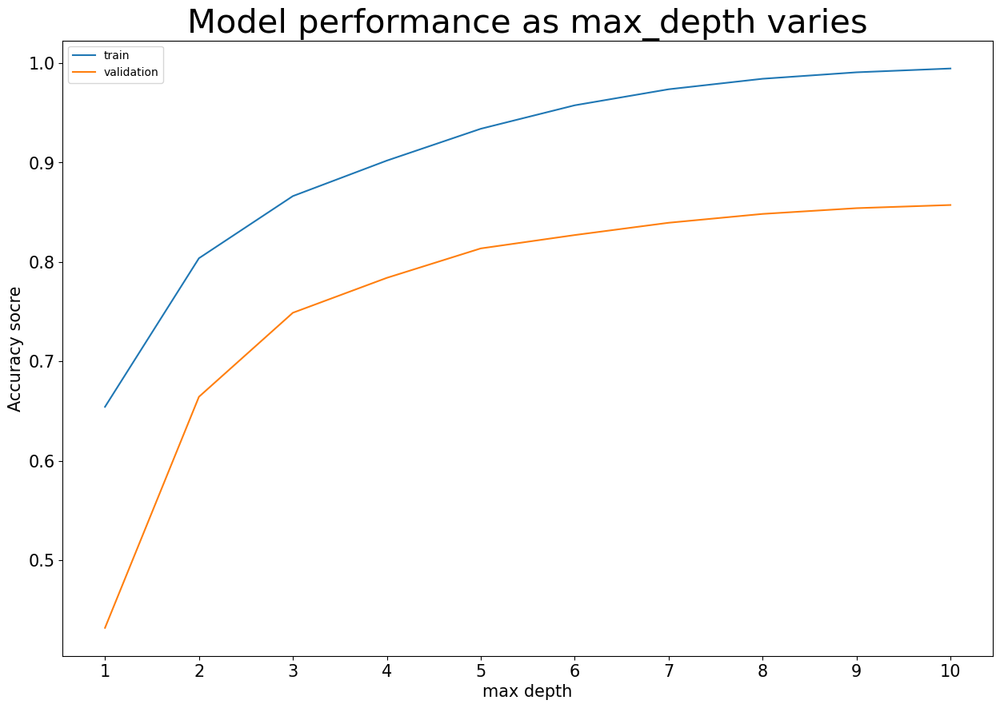

In [113]:
plt.figure(figsize=(15,10))
plt.plot(tree_depth,rand_train,label = 'train')
plt.plot(tree_depth,rand_validation,label = 'validation')
plt.xticks(tree_depth)
plt.xlabel("max depth", fontsize=15)
plt.ylabel("Accuracy socre", fontsize = 15)
plt.title("Model performance as max_depth varies", fontsize=30)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend()
plt.show()

The random forest model has overfitting problem and the problem becomes wores when max_depth more than 5.
Then I will try to adjust the n_estimators hyperparameter with the max_depth = 5.

Due to hardware problem, I will only find out the best n_estimators within 500.

In [114]:
# create list to store the accuracy score
rand_train_n = []
rand_validation_n = []

# can change the range of n_estimators
n_est = range(50,501,50)

# for loop to record result for different n_estimators
for n in n_est:
    rand_model_n = RandomForestRegressor(max_depth= 5, n_estimators = n, random_state=1)
    
    rand_model_n.fit(X_train, y_train)
    
    rand_train_n.append(rand_model_n.score(X_train, y_train))
    rand_validation_n.append(rand_model_n.score(X_validation, y_validation))

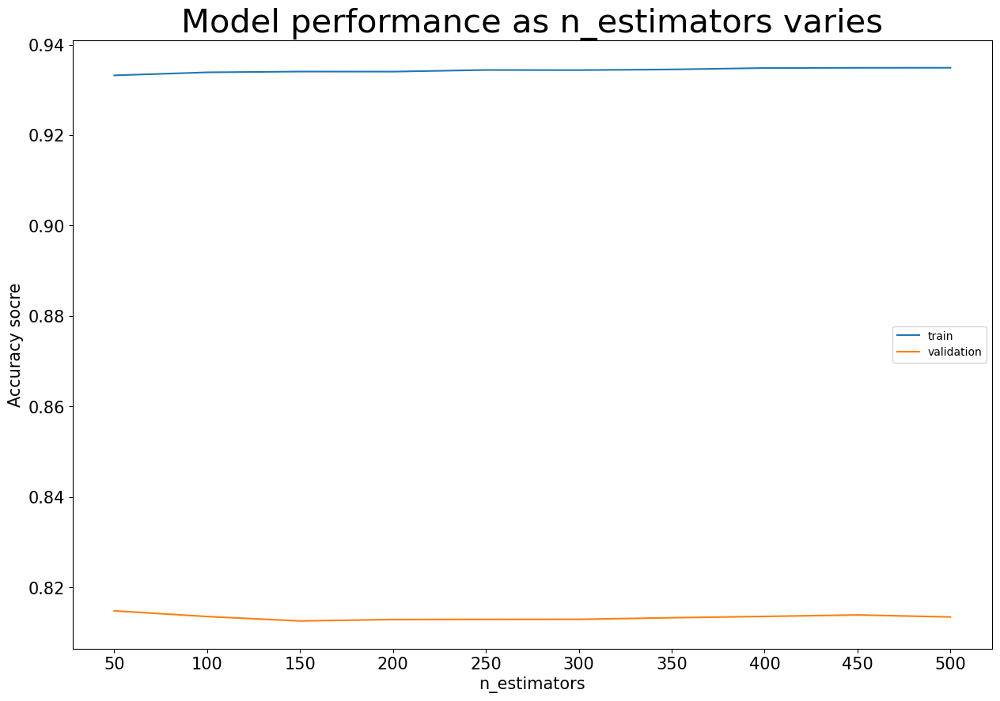

In [115]:
plt.figure(figsize=(15,10))
plt.plot(n_est,rand_train_n,label = 'train')
plt.plot(n_est,rand_validation_n,label = 'validation')
plt.xticks(n_est)
plt.xlabel("n_estimators", fontsize=15)
plt.ylabel("Accuracy socre", fontsize = 15)
plt.title("Model performance as n_estimators varies", fontsize=30)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend()
plt.show()

Seems the optimizing n_estimators cannot solve the overfitting or increase the prediction power for n_estimators within 500. I will just choose the n_estimators=500 for the model building.

I will build a random forest model with max_depth=5 and n_estimators=500 after hyperparameter optimization.

In [116]:
random_forest_model = RandomForestRegressor(max_depth=5, n_estimators=500 ,random_state=1)
random_forest_model.fit(X_remainder, y_remainder)
print(f"The accuracy score of remainder set is {random_forest_model.score(X_remainder, y_remainder)}")
print(f"The accuracy score of test set is {random_forest_model.score(X_test, y_test)}")

The accuracy score of remainder set is 0.9261591042506513
The accuracy score of test set is 0.7328028287450099


As the accuracy score is still the highest among all the model, I will try to reduce the feature to see how the model performs. 
Let's select the features that has the highest importance for the model<sub>[Ref_3](#3)</sub>.

In [117]:
# create a data frame to store the feature and its importance of the model
top_imp_df = pd.DataFrame({'feature': random_forest_model.feature_names_in_,'importance': random_forest_model.feature_importances_})

# sort the data frame by importance
top_imp_df = top_imp_df.sort_values(by='importance', ascending=False)

In [118]:
top_imp_df.reset_index(inplace=True, drop=True)
top_imp_df

,feature,importance
0,Fixed telephone subscriptions (per 100 people),7.265875e-01
1,"Birth rate, crude (per 1,000 people)",1.613057e-01
2,"GNI per capita, Atlas method (current US$)",3.042265e-02
3,Merchandise imports from low- and middle-incom...,1.131789e-02
4,"Fertility rate, total (births per woman)",8.543533e-03
...,...,...
174,Adjusted savings: mineral depletion (% of GNI),7.125761e-08
175,GDP growth (annual %),0.000000e+00
176,Primary school starting age (years),0.000000e+00
177,Net ODA received (% of GNI),0.000000e+00


With the about data frame, let's find out the top 10 important features for the model.

In [119]:
# find out the top 10 feature with the highest importance
rand_10 = top_imp_df['feature'].head(10)
for i in rand_10:
    print(f"'{i}',")

'Fixed telephone subscriptions (per 100 people)',
'Birth rate, crude (per 1,000 people)',
'GNI per capita, Atlas method (current US$)',
'Merchandise imports from low- and middle-income economies in Sub-Saharan Africa (% of total merchandise imports)',
'Fertility rate, total (births per woman)',
'Merchandise exports to low- and middle-income economies in Sub-Saharan Africa (% of total merchandise exports)',
'GDP per capita (current US$)',
'Adjusted net national income per capita (current US$)',
'Age dependency ratio (% of working-age population)',
'Coal rents (% of GDP)',


In [120]:
rand_top_10=['Fixed telephone subscriptions (per 100 people)',
'Birth rate, crude (per 1,000 people)',
'GNI per capita, Atlas method (current US$)',
'Merchandise imports from low- and middle-income economies in Sub-Saharan Africa (% of total merchandise imports)',
'Fertility rate, total (births per woman)',
'Merchandise exports to low- and middle-income economies in Sub-Saharan Africa (% of total merchandise exports)',
'GDP per capita (current US$)',
'Adjusted net national income per capita (current US$)',
'Age dependency ratio (% of working-age population)',
'Coal rents (% of GDP)']

Let's see the accuracy score for the model with top 10 features.

In [121]:
random_forest_model = RandomForestRegressor(random_state=1)
random_forest_model.fit(X_train[rand_top_10], y_train,)
print(f"Train: {random_forest_model.score(X_train[rand_top_10], y_train)}")
print(f"Validation: {random_forest_model.score(X_validation[rand_top_10], y_validation)}")

Train: 0.9965796089316237
Validation: 0.8713509502131913


The model still has good performance compare with other models. Same as above, I will to limit the max_depth to minimize the overfitting problem.

In [122]:
rand_train = []
rand_validation = []

tree_depth = range(1,11)

for depth in tree_depth:
    rand_model = RandomForestRegressor(max_depth= depth, random_state=1)
    
    rand_model.fit(X_train[rand_top_10], y_train)
    
    rand_train.append(rand_model.score(X_train[rand_top_10], y_train))
    rand_validation.append(rand_model.score(X_validation[rand_top_10], y_validation))

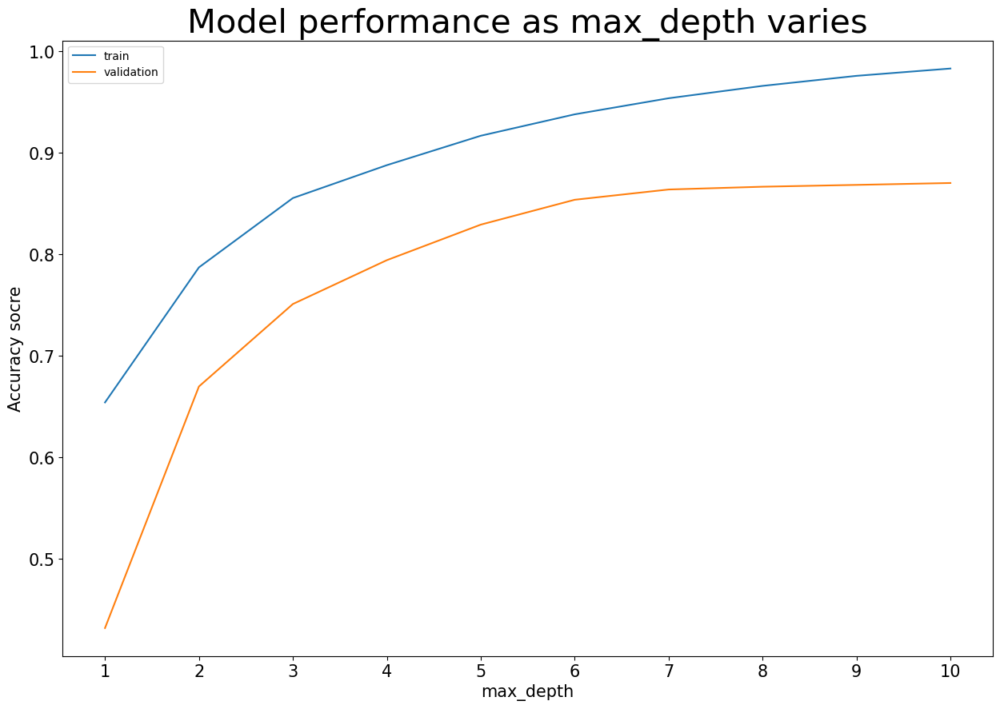

In [123]:
plt.figure(figsize=(15,10))
plt.plot(tree_depth,rand_train,label = 'train')
plt.plot(tree_depth,rand_validation,label = 'validation')
plt.xticks(tree_depth)
plt.xlabel("max_depth", fontsize= 15)
plt.ylabel("Accuracy socre", fontsize= 15)
plt.title("Model performance as max_depth varies",fontsize= 30)
plt.yticks(fontsize=15)
plt.xticks(fontsize= 15)
plt.legend()
plt.show()

From the above plot, the model is always overfitting and the problem become worse when max_depth is larger than 5.

I will find out the best n_estimators within 500.

In [124]:
# create list to store the accuracy score
rand_train_n_10 = []
rand_validation_n_10 = []

# can change the range of n_estimators
n_est = range(50,501,50)

# for loop to record result for different n_estimators
for n in n_est:
    rand_model_n = RandomForestRegressor(max_depth= 5, n_estimators = n, random_state=1)
    
    rand_model_n.fit(X_train, y_train)
    
    rand_train_n_10.append(rand_model_n.score(X_train, y_train))
    rand_validation_n_10.append(rand_model_n.score(X_validation, y_validation))

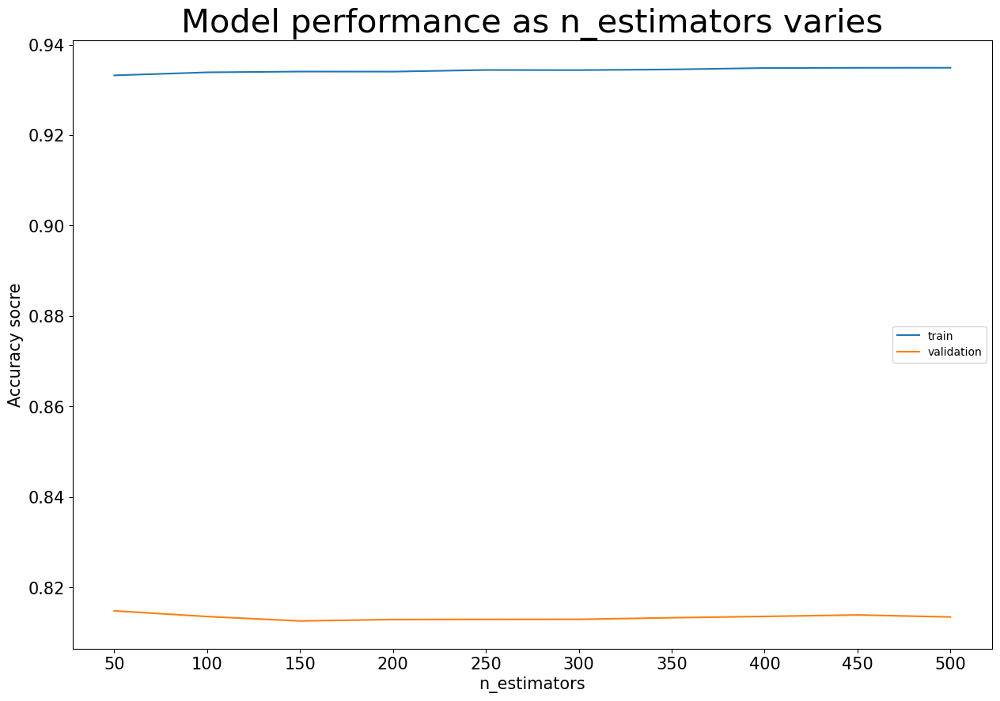

In [125]:
plt.figure(figsize=(15,10))
plt.plot(n_est,rand_train_n_10,label = 'train')
plt.plot(n_est,rand_validation_n_10,label = 'validation')
plt.xticks(n_est)
plt.xlabel("n_estimators", fontsize=15)
plt.ylabel("Accuracy socre", fontsize = 15)
plt.title("Model performance as n_estimators varies", fontsize=30)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend()
plt.show()

The overfitting problem and the accuracy score do not have much improvement when optimizing the hyperparameter for n_estimators within 500.

For this time, I will build a model with 10 features with max_depth = 5 and n_estimators = 500

In [126]:
rand_model_10 = RandomForestRegressor(max_depth= 5, n_estimators=500, random_state=1)
    
rand_model_10.fit(X_remainder[rand_top_10], y_remainder)
    
print(f"The accuracy score of ramainder set is {rand_model_10.score(X_validation[rand_top_10], y_validation)}")
print(f"The accuracy score of test set is  {rand_model_10.score(X_test[rand_top_10], y_test)}")

The accuracy score of ramainder set is 0.9083131372900658
The accuracy score of test set is  0.7140216498290892


Let see compare the R<sup>2</sup> of the original and the model with 10 features.

In [127]:
# compare the perdicting power with the original model
print(f"The model with 10 features has {round(0.714/0.733*100,1)}% R^2 as the original model")

The model with 10 features has 97.4% R^2 as the original model


For the random forest model with only 10 features, it still have a good predicting power. I think it is worth to sacrifice some predicting power to get a faster prediction model(the features decrease from 179 to 10 and still has more than 97% of the original model performance)

Here are the R<sup>2</sup> of the models built of the capstone project:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |
|KNN regression           | 0.229                       | 0.608                      |
|SVR                      | N.A.                        | 0.428                      |
|Decision tree regression | 0.670                       | 0.675                      |
|Random forest regression | 0.733                       | 0.714                      |

## <a id='evaluation'>Model evaluation</a>

From the two best performing models(decision tree and random forest model, I found that they share some simlar features on the top 10 important features for their model.

In [128]:
tree_10

['Fixed telephone subscriptions (per 100 people)',
 'Birth rate, crude (per 1,000 people)',
 'Age dependency ratio, young (% of working-age population)',
 'GNI per capita, Atlas method (current US$)',
 'Fertility rate, total (births per woman)',
 'Adolescent fertility rate (births per 1,000 women ages 15-19)',
 'Age dependency ratio, old (% of working-age population)',
 'Age dependency ratio (% of working-age population)',
 'Fertilizer consumption (kilograms per hectare of arable land)',
 'Agricultural land (sq. km)']

In [129]:
rand_top_10

['Fixed telephone subscriptions (per 100 people)',
 'Birth rate, crude (per 1,000 people)',
 'GNI per capita, Atlas method (current US$)',
 'Merchandise imports from low- and middle-income economies in Sub-Saharan Africa (% of total merchandise imports)',
 'Fertility rate, total (births per woman)',
 'Merchandise exports to low- and middle-income economies in Sub-Saharan Africa (% of total merchandise exports)',
 'GDP per capita (current US$)',
 'Adjusted net national income per capita (current US$)',
 'Age dependency ratio (% of working-age population)',
 'Coal rents (% of GDP)']

From the above features, I came out of different categories from the most important features.

Infrastructure - Fixed telephone subscriptions

Population - Birth rate, fertility rate

Economy - GDP/GNI per capita, age dependency ratio

The best performing model is the random forest regression model, it has 0.733 R<sup>2</sup> with all the features. Even I use the top 10 important feature to build the model, it is still the best model compare to all other models.

For the top 10 features from the random forest model, I want to see what is the realtionship of those features with the life expectancy.

In [130]:
rand_top_10

['Fixed telephone subscriptions (per 100 people)',
 'Birth rate, crude (per 1,000 people)',
 'GNI per capita, Atlas method (current US$)',
 'Merchandise imports from low- and middle-income economies in Sub-Saharan Africa (% of total merchandise imports)',
 'Fertility rate, total (births per woman)',
 'Merchandise exports to low- and middle-income economies in Sub-Saharan Africa (% of total merchandise exports)',
 'GDP per capita (current US$)',
 'Adjusted net national income per capita (current US$)',
 'Age dependency ratio (% of working-age population)',
 'Coal rents (% of GDP)']

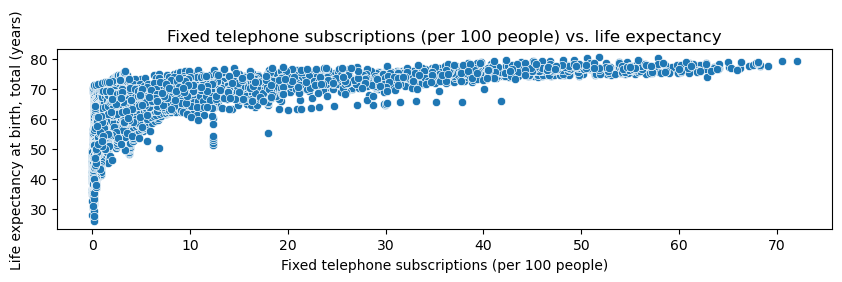

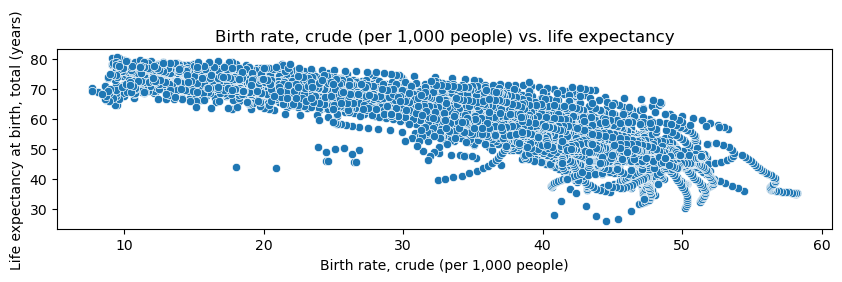

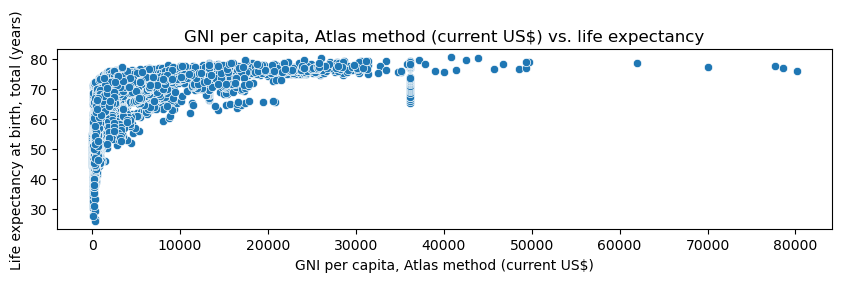

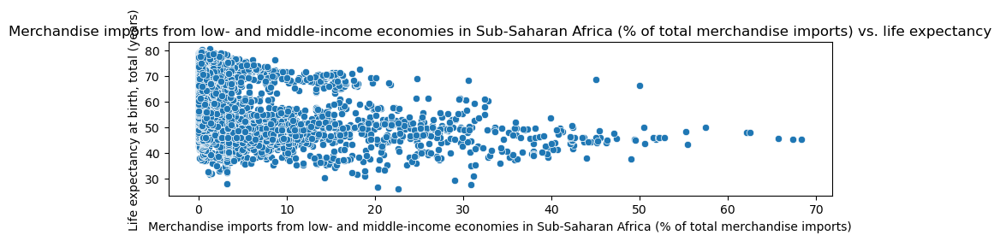

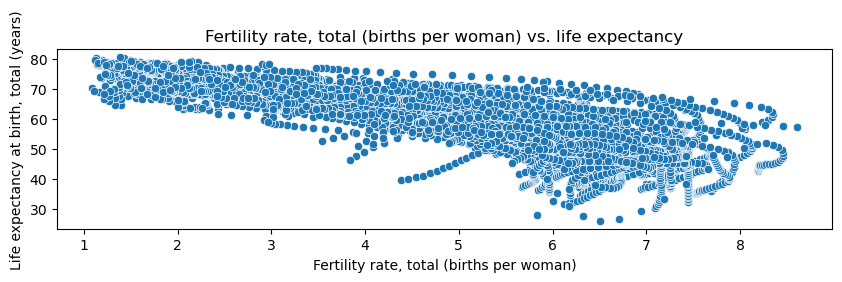

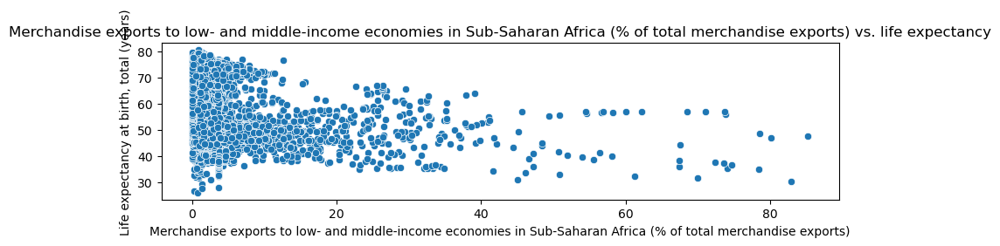

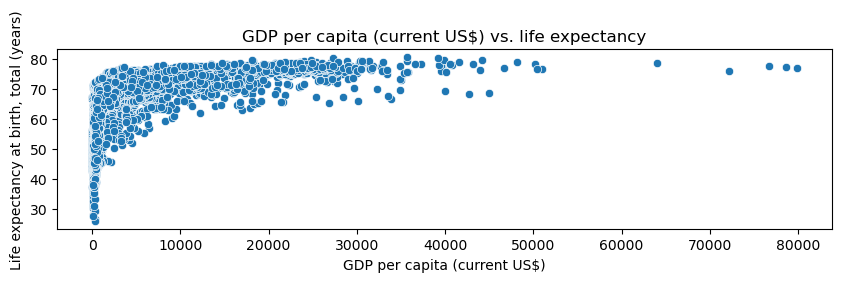

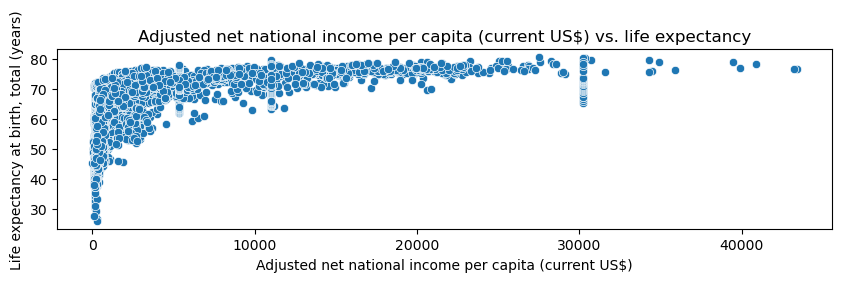

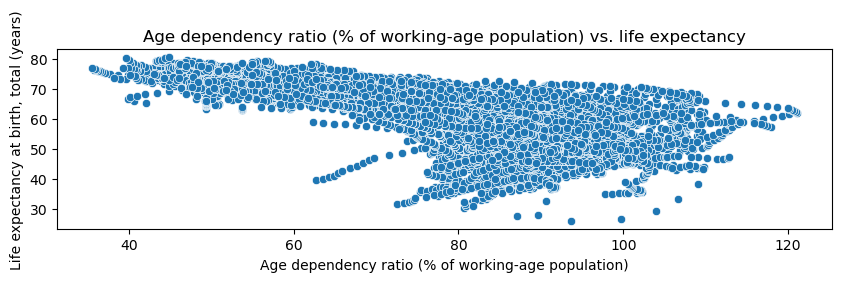

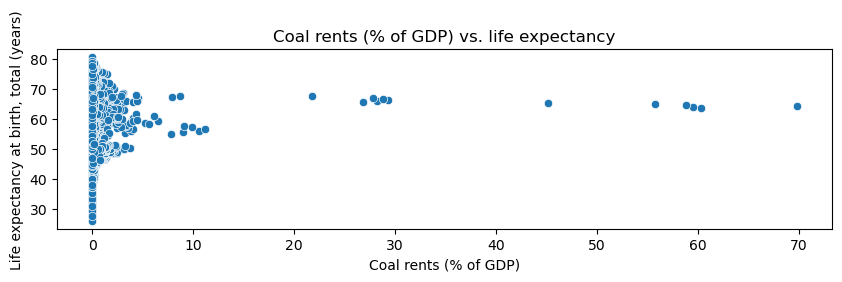

In [131]:
# write a for loop to plot scatter for the top 10 features
for i in range(len(X_validation[rand_top_10].columns)):
    plt.figure(figsize=(10,500))
    plt.subplot(len(X.columns),1,i+1)
    sns.scatterplot(x=X_train[X_train[rand_top_10].columns[i]],y=y)
    plt.title(f"{rand_top_10[i]} vs. life expectancy")
    plt.show()

Although most features do not have a linear relationship with the life expectancy, there are some positive/negative effect can be observed.

Features with positive effect on life expectancy:
- Fixed telephone subscriptions (per 100 people)
- GNI per capita, Atlas method (current US\$)
- GDP per capita (current US\$)
- Adjusted net national income per capita (current US$)
- Fertility rate, total (births per woman)

Features with engative effect on life expectancy:
- Birth rate, crude (per 1,000 people)
- Merchandise imports/exports from low- and middle-income economies in Sub-Saharan Africa (% of total merchandise imports)
- Age dependency ratio (% of working-age population)
- Coal rents (% of GDP)

Let's try to use the model with 10 most important feature to predict the life expectancy, then to visualize it by the plot.

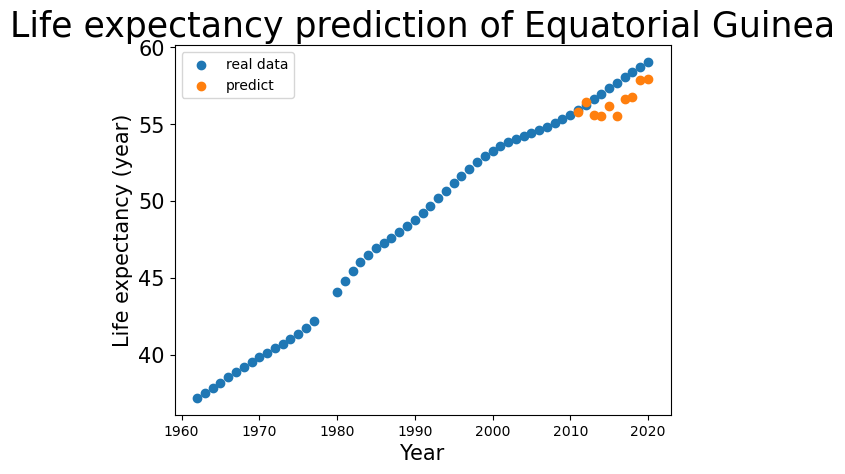

In [148]:
# can run the code for several times to see the prediction of different country

# choose a random country
import random
random_country = random.sample(list(df_modeling['Country'].unique()),k=1)[0]

# create a data frame that the data are from X_test
predict = df_modeling[(df_modeling['Country'] == random_country) & (df_modeling['Year'] > 2010)].drop(['Country', 'GDP per capita group', 'Life expectancy at birth, total (years)', 'Year'],axis=1)

# create a list to record the prediction of life expectancy
random_list = []

# write a for loop to append the predicted life expectancy for the random country
for i in range(predict.shape[0]):
    random_list.append(rand_model_10.predict(np.array(predict.iloc[i,:][rand_top_10]).reshape(1,-1))[0])
    

# plot the scatter to see the difference of real data and prediction
plt.figure()

plt.scatter(y=df_clean[df_clean['Country'] == random_country]['Life expectancy at birth, total (years)'], x= df_clean[df_clean['Country'] == random_country]['Year'], label='real data')

plt.scatter(y = random_list, x= df_modeling[(df_modeling['Country'] == random_country) & (df_modeling['Year'] > 2010)]['Year'], label='predict')

plt.title(f'Life expectancy prediction of {random_country}', fontsize=25)
plt.xlabel('Year', fontsize=15)
plt.ylabel('Life expectancy (year)', fontsize=15)
plt.xticks(fontsize=10)
plt.yticks(fontsize=15)
plt.legend()

plt.show()

From the above plot, I found that the life expectancy of some countries are well predicted, such as Equatorial Guinea, Guinea-Bissau and Mauritius. But some prediction for some countries does not perform well, such as Italy and Canada. 


Althouth the model is not prefect, it can still predict the life expectancy within 5 years of the real data in most of the time.
Also, from my observation, the model seems have higher accuracy on predicting countries from less developed countries than the more developed countries, which further invesgitation needed to be done to find out the reason.

## <a id='conclusion'>Conclusion</a>

For this capstone project, I had some findings for different process.

### EDA
- The life expectancy has a slightly left skewed distribution.

- The average life expectancy over the world increases over for the past 60 years for around 50%.

- For the row with higher GDP per capita, it usually has higher life expectancy.


### Modeling
- The model with highest accuracy score is random forest regression model and it have up to 0.733 R<sup>2</sup>. Even I built a model with the top 10 important features, it still has more than 90% of perfomance of the original model and the best performing model compare to other models.

- The predicting power of different models are the following:

|                         | R<sup>2</sup> (All features)|R<sup>2</sup> (10 features) |
|-------------------------|-----------------------------|----------------------------|
|Linear regression        | N.A.                        | 0.366                      |
|Ridge                    | N.A.                        | 0.364                      |
|KNN regression           | 0.229                       | 0.608                      |
|SVR                      | N.A.                        | 0.428                      |
|Decision tree regression | 0.670                       | 0.675                      |
|Random forest regression | 0.733                       | 0.714                      |

- For the modeling process, the basic linear regression has 0.366 R<sup>2</sup>, which I will consider this as the base line of the prediction. For the random forest regression model with 10 features has 100% better prediction accuracy than the base line.

### Model evaluation
- For the two best performing model(decision tree and random forest model), they both share some simlar features on the top 10 important features for their model.

- The most important features of the random forest model are come from the infrastructyre, population and economy categories.

- For the reandom forest model with 10 features, the predicted life expectancy usually has less than 5 years of difference with the real data.

- The model seems to have a better accuracy on predicting the life expectancy for less developed countries than the more developed countries.

## <a id='limition'>Limition</a>
- After the data cleaning process, only 12330 rows of data were left, which maybe too small for machine learning. A larger data set can be found to build a better model.


- For the dataset I obtained from the World Bank, it has a lot of missing values of different features. So I removed those features that have over 40% missing values and filled in those values by the median of each GDP per capita group, which may be inaccurate on predicting on those values and affect the model learning. A better data set that has less missing values and more features is needed for to build more accurate model. 


- Due to hardware and time limition, I did not have time to do better hyperparameter optimization and build some deep learning models, which may protentially have a higher accuracy on predicting the life expectancy.



## <a id='future'>Future action</a>

- For the model that I built from the model, the overfitting problem always happens as there are some difference between the train and validation set(at least 0.1 on the R<sup>2</sup> score), which I will try to do a more detail hyperperimeter optimation in the furrure.


- For the modeling process, there are some models have lower R<sup>2</sup> score for all features were put into the model than the model built by 10 features(especially on the KNN regression and SVR model), further invegestion needs to be done to find out the problem.


- For this capstone project, I investigated the life expactiency in a country level. My next step is to have a more precise life prediction on individual person. I need to get a dataset of the lifestyle of different people and try to build a model on life expectancy.


## <a id='references'>References</a>
<a id='1'>Ref_1</a> : World Development Indicators

https://datacatalog.worldbank.org/search/dataset/0037712/World-Development-Indicators


<a id='2'>Ref_2</a> :Feature Selection Using Random forest

https://towardsdatascience.com/feature-selection-using-random-forest-26d7b747597f


<a id = '3'>Ref_3</a> : How to select features after running DecisionTreeRegressor algorithm?

https://stackoverflow.com/questions/68914158/how-to-select-features-after-running-decisiontreeregressor-algorithm